In [3]:
import logging
import time
from pprint import pprint
from typing import List

import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import pyro
import pyro.distributions as dist
import pyro.optim as optim
import seaborn as sns
import torch
from IPython.display import HTML
from pyro.infer import SVI, Predictive, Trace_ELBO
from pyro.infer.autoguide import AutoMultivariateNormal, init_to_mean

from collab2.foraging.fish import StochasticFish_IndependentRates,animate_trajectories
from collab2.foraging.toolkit import (
    animate_predictors,
    dataObject,
    derive_predictors_and_scores,
    plot_coefs,
    rescale_to_grid,
    subsample_frames_constant_frame_rate
)

folder_path = "/Users/palka/Documents/Repositories/collab-creatures/data/foraging/two_fish"


# Parameters for discretization and predictor derivation

In [6]:
frames_skipped = 10 
dt = 5
window_size = 10 # grid-units, smaller than step-size
sigma_v = 5 # units: grid-unit/frame-interval
sigma_t = np.pi/8 
L_list = [10,40,70,100] #grid_units

# grid_size = arena_size for each experiment


score_kwargs = {
    "nextStepExponential" : {
        "decay_length" : 5
    }
}

predictor_kwargs = {
    "velocityDiffusion" : {
        "sigma_v" : sigma_v,
        "sigma_t" : sigma_t,
        "dt" : dt
    }
}

for L in L_list:
    predictor_kwargs[f"pairwiseCopying_{L}"] = {
        "sigma_v" : sigma_v,
        "sigma_t" : sigma_t,
        "dt" : dt,
        "interaction_length" : L
    }

display(predictor_kwargs)

# define circular grid constraint function
def circular_constraint_func(grid, c_x, c_y, R):
    ind = ((grid["x"] - c_x) ** 2 + (grid["y"] - c_y) ** 2) < R**2
    return grid.loc[ind]


# save inference results for each experiment here
exp_details = pd.read_csv(f"{folder_path}/exp_details.csv")

all_exp_samples = {exp : {} for exp in exp_details["experiment"]}


{'velocityDiffusion': {'sigma_v': 5, 'sigma_t': 0.39269908169872414, 'dt': 5},
 'pairwiseCopying_10': {'sigma_v': 5,
  'sigma_t': 0.39269908169872414,
  'dt': 5,
  'interaction_length': 10},
 'pairwiseCopying_40': {'sigma_v': 5,
  'sigma_t': 0.39269908169872414,
  'dt': 5,
  'interaction_length': 40},
 'pairwiseCopying_70': {'sigma_v': 5,
  'sigma_t': 0.39269908169872414,
  'dt': 5,
  'interaction_length': 70},
 'pairwiseCopying_100': {'sigma_v': 5,
  'sigma_t': 0.39269908169872414,
  'dt': 5,
  'interaction_length': 100}}

# Helper functions for inference

In [7]:
def get_tensors_for_inference(
    derivedDF: pd.DataFrame, predictor_names: List[str], score_names: List[str]
):
    predictors = {}
    for name in predictor_names:
        predictors[name] = torch.tensor(derivedDF[name].values)

    scores = {}
    for name in score_names:
        scores[name] = torch.tensor(derivedDF[name].values)

    return predictors, scores


def run_svi_and_get_samples(
    model, predictors, score, num_svi_iters=600, verbose=True, num_samples=1000
):
    guide = AutoMultivariateNormal(model, init_loc_fn=init_to_mean)
    svi = SVI(model, guide, optim.Adam({"lr": 0.01}), loss=Trace_ELBO())

    iterations = []
    losses = []

    logging.info(f"Starting SVI inference with {num_svi_iters} iterations.")
    start_time = time.time()
    pyro.clear_param_store()
    for i in range(num_svi_iters):
        elbo = svi.step(predictors=predictors, score=score)
        iterations.append(i)
        losses.append(elbo)
        if i % 200 == 0:
            logging.info("Step {}, elbo loss: {}".format(i, elbo))
    end_time = time.time()
    elapsed_time = end_time - start_time
    logging.info("SVI inference completed in %.2f seconds.", elapsed_time)

    if verbose:
        fig = px.line(
            x=iterations, y=losses, title="ELBO loss", template="presentation"
        )
        labels = {"iterations": "iteration", "losses": "loss"}
        fig.update_xaxes(showgrid=False, title_text=labels["iterations"])
        fig.update_yaxes(showgrid=False, title_text=labels["losses"])
        fig.update_layout(width=700)
        fig.show()

    site_names = [f"weight_{key}" for key in predictors.keys()]
    predictive = Predictive(
        model=model,
        guide=guide,
        num_samples=num_samples,
        parallel=False,
        return_sites=site_names,
    )
    samples = predictive(predictors=predictors, score=score)
    return guide, samples

## Pyro model

In [8]:
class FishModel(pyro.nn.PyroModule):
    def __init__(self, predictors: dict, score: dict):
        super().__init__()

        self.predictors = predictors
        self.score = score
        self.n = len(score)

    def forward(self, predictors=None, score=None):
        if predictors is None:
            predictors = self.predictors

        size = len(next(iter(predictors.values())))

        weights = {}
        sigmas = {}
        for key in predictors.keys():
            weights[key] = pyro.sample(f"weight_{key}", dist.Normal(0.0, 1))
            sigmas[key] = pyro.sample(f"sigma_{key}", dist.Exponential(10.0))

        weights["b"] = pyro.sample("b", dist.Normal(0.5, 0.3))
        sigmas["bs"] = pyro.sample("bs", dist.Exponential(10.0))

        with pyro.plate("data", size):
            sigma = pyro.deterministic(
                "sigma",
                sum([predictors[key] * sigmas[key] for key in predictors.keys()])
                + sigmas["bs"],
            )

            assert torch.all(sigma > 0), "Sigma is not positive"

            mean = pyro.deterministic(
                "mean",
                sum([predictors[key] * weights[key] for key in predictors.keys()])
                + weights["b"],
            )

            observed_score = None
            if score is not None:
                observed_score = next(iter(score.values()))

            pyro.sample("predicted_score", dist.Normal(mean, sigma), obs=observed_score)

## Helper functions for model evaluation

In [9]:
# getting score predictions is slower. only do that for a fraction of datapoints
# and fewer samples!
def evaluate_performance(
    model, guide, predictors, score, num_samples=100, sampling_fraction=1
):
    score_name = next(iter(score.keys()))

    sub_size = int(score[score_name].size(0) * sampling_fraction)
    randinds = torch.randint(0, score[score_name].size(0), (sub_size,))

    # downsample predictors and score
    score_sub = {score_name: score[score_name][randinds]}

    predictors_sub = {}
    for key, value in predictors.items():
        predictors_sub[key] = value[randinds]

    predictive = Predictive(
        model=model,
        guide=guide,
        num_samples=num_samples,
        parallel=False,
        return_sites=["predicted_score"],
    )
    samples = predictive(predictors=predictors_sub, score=None)

    predictions = samples["predicted_score"]

    predictions_mean = predictions.mean(dim=0)
    predictions_lower = predictions.quantile(0.025, dim=0)
    predictions_upper = predictions.quantile(0.975, dim=0)

    coverage = (
        (
            (predictions_lower <= score_sub[score_name])
            & (score_sub[score_name] <= predictions_upper)
        )
        .float()
        .mean()
    )

    observed_mean = score_sub[score_name].mean()

    residuals = score_sub[score_name] - predictions_mean

    mae = (torch.abs(residuals)).mean()

    rsquared = 1 - (
        torch.sum(residuals**2)
        / torch.sum((score_sub[score_name] - observed_mean) ** 2)
    )

    fig, ax = plt.subplots(1, 2, figsize=(10, 5))

    heatmap = ax[0].hexbin(
        score_sub[score_name],
        predictions_mean,
        gridsize=100,
        cmap="Blues",
        norm=mpl.colors.LogNorm(),
    )
    fig.colorbar(heatmap, ax=ax[0])
    ax[0].set_title("Ratio of outcomes within 95% CI: {:.2f}".format(coverage.item()))
    ax[0].set_xlabel("observed values")
    ax[0].set_ylabel("mean predicted values")

    ax[1].hist(residuals.detach().numpy(), bins=50)
    ax[1].set_title(f"Residuals, MAE: {mae.item():.2f}, R²: {rsquared.item():.2f}")
    ax[1].set_xlabel("residuals")
    ax[1].set_ylabel("count")

    # print(f"Residuals, MAE: {mae.item():.2f}, R²: {rsquared.item():.2f}")

    plt.tight_layout(rect=(0, 0, 1, 0.96))
    sns.despine()
    fig.suptitle("Model evaluation", fontsize=16)
    plt.show()

## Helper functions for visualization

In [10]:
def plot_density(predictors, scores, title):
    n_plots = len(predictors) * len(scores)
    #print(n_plots)
    ncols = 3
    nrows = np.ceil(n_plots / ncols).astype(int)
    fig, axes = plt.subplots(nrows, ncols, figsize=(4 * ncols, 3 * nrows))

    plot_index = 0
    for i, predictor_name in enumerate(predictors.keys()):
        for j, score_name in enumerate(scores.keys()):

            if nrows > 1:
                r = plot_index // ncols
                c = plot_index % ncols
                #print([r,c])
                ax = axes[r, c]
            else:
                ax = axes[plot_index]

            heatmap = ax.hexbin(
                predictors[predictor_name],
                scores[score_name],
                gridsize=100,
                cmap="Blues",
                norm=mpl.colors.LogNorm(),
            )
            fig.colorbar(heatmap, ax=ax)
            ax.set_xlabel(f"{predictor_name} predictor")
            ax.set_ylabel(f"{score_name} score")
            # ax.set_aspect("equal")
            plot_index += 1

    # remove unused plots
    if n_plots % ncols:
        for ind in range(n_plots % ncols, ncols):
            if nrows > 1:
                fig.delaxes(axes[nrows-1,ind])
            else:
                fig.delaxes(axes[ind])

    fig.suptitle(title)
    fig.tight_layout()


def plot_distributions(derivedDF, column_names):
    fig, ax = plt.subplots(1, len(column_names), figsize=(3 * len(column_names), 3))

    for i, column in enumerate(column_names):
        ax[i].hist(derivedDF[column], bins=20, density=True, alpha=1)
        ax[i].set_yscale("log")
        ax[i].set_ylim([10**-3, 10**2])
        ax[i].set_xlabel(column)
        ax[i].set_ylabel("PDF")

    fig.tight_layout()

# Run inference for each experiment

--------------------------------------------------
Starting analysis of experiment: 2wks0
--------------------------------------------------
original_frames: 36144
original_shape: (72288, 4)
resulting_frames: 3615
resulting_shape: (7230, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(
2024-10-11 19:23:00,160 - Local windows completed in 33.36 seconds.
2024-10-11 19:23:21,440 - velocityDiffusion completed in 21.28 seconds.
2024-10-11 19:23:52,633 - pairwiseCopying_10 completed in 31.19 seconds.
2024-10-11 19:24:31,610 - pairwiseCopying_40 completed in 38.98 seconds.
2024-10-11 19:25:14,021 - pairwiseCopying_70 completed in 42.41 seconds.
2024-10-11 19:25:59,626 - pairwiseCopying_100 completed in 45.60 seconds.
2024-10-11 19:26:11,519 - nextStepExponential completed in 11.89 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/der

Fraction of frames with both fish present : 0.6232365145228216


2024-10-11 19:27:27,874 - Starting SVI inference with 1000 iterations.
2024-10-11 19:27:28,123 - Step 0, elbo loss: 591573.3187960967
2024-10-11 19:27:53,281 - Step 200, elbo loss: 194815.59496247393
2024-10-11 19:28:18,578 - Step 400, elbo loss: 158357.03078753187
2024-10-11 19:28:44,159 - Step 600, elbo loss: 134052.28634974052
2024-10-11 19:29:16,550 - Step 800, elbo loss: 135619.9596769708
2024-10-11 19:29:43,407 - SVI inference completed in 135.53 seconds.


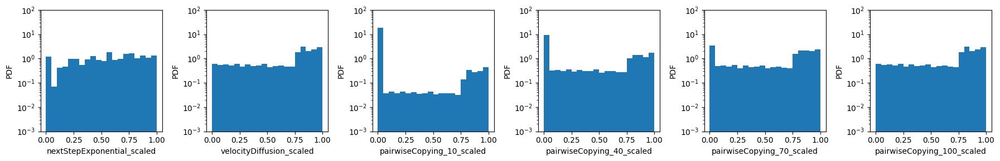

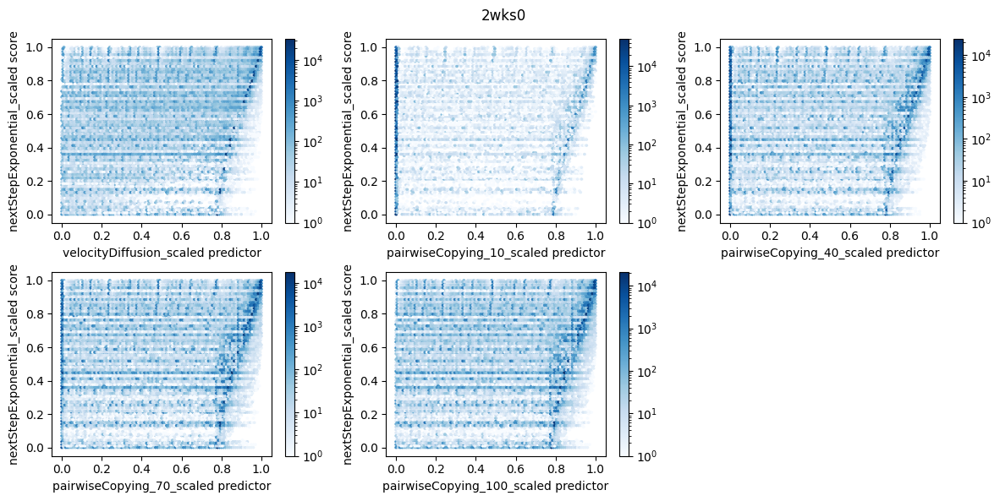

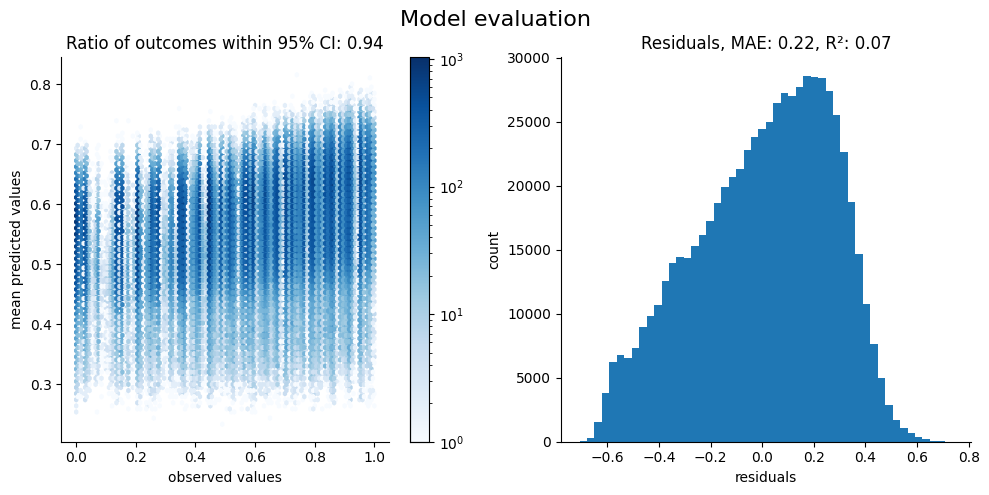

--------------------------------------------------
Starting analysis of experiment: 2wks1
--------------------------------------------------
original_frames: 35500
original_shape: (71000, 4)
resulting_frames: 3550
resulting_shape: (7100, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 19:31:16,362 - Local windows completed in 22.22 seconds.
2024-10-11 19:31:26,923 - velocityDiffusion completed in 10.56 seconds.
2024-10-11 19:31:47,512 - pairwiseCopying_10 completed in 20.59 seconds.
2024-10-11 19:32:08,844 - pairwiseCopying_40 completed in 21.33 seconds.
2024-10-11 19:32:36,923 - pairwiseCopying_70 completed in 28.08 seconds.
2024-10-11 19:33:06,515 - pairwiseCopying_100 completed in 29.59 seconds.
2024-10-11 19:33:13,750 - nextStepExponential completed in 7.23 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.45661971830985915


2024-10-11 19:34:11,933 - Starting SVI inference with 1000 iterations.
2024-10-11 19:34:12,104 - Step 0, elbo loss: 285109.37840712466
2024-10-11 19:34:33,045 - Step 200, elbo loss: 139413.98800675574
2024-10-11 19:34:52,182 - Step 400, elbo loss: 109632.90724420434
2024-10-11 19:35:13,434 - Step 600, elbo loss: 103282.44437369335
2024-10-11 19:35:40,252 - Step 800, elbo loss: 89210.83421774149
2024-10-11 19:35:59,287 - SVI inference completed in 107.35 seconds.


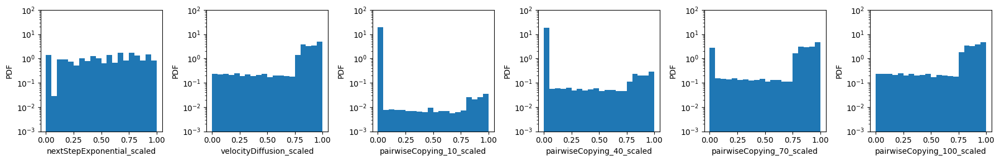

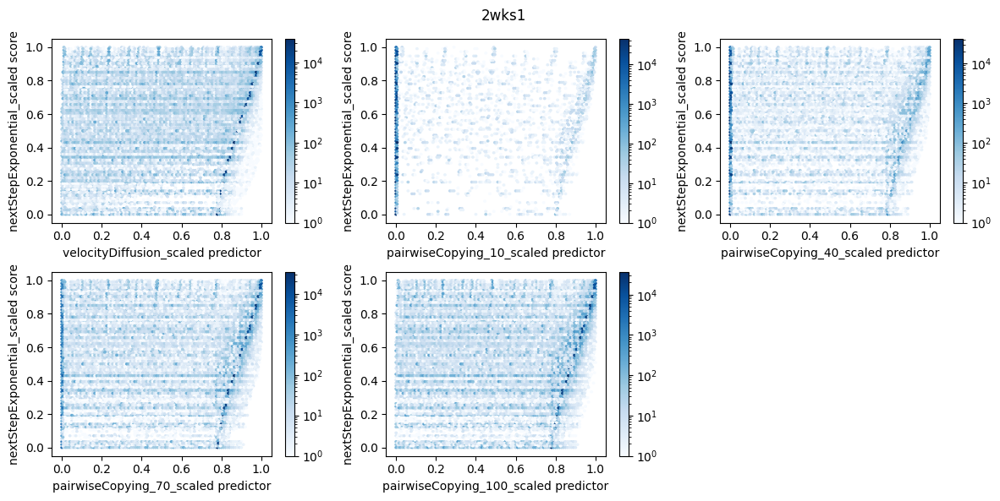

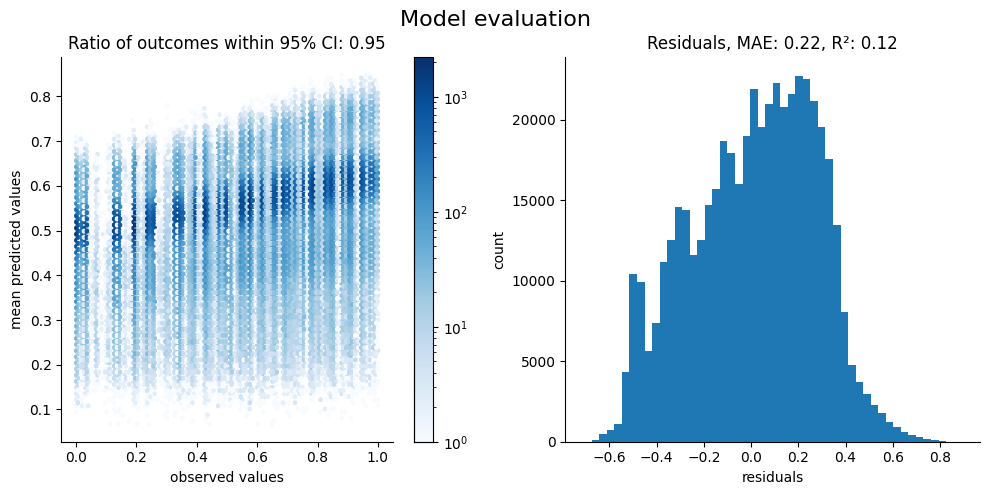

--------------------------------------------------
Starting analysis of experiment: 2wks3
--------------------------------------------------
original_frames: 35423
original_shape: (70846, 4)
resulting_frames: 3543
resulting_shape: (7086, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 19:37:24,444 - Local windows completed in 34.83 seconds.
2024-10-11 19:37:48,814 - velocityDiffusion completed in 24.37 seconds.
2024-10-11 19:38:22,286 - pairwiseCopying_10 completed in 33.47 seconds.
2024-10-11 19:38:58,423 - pairwiseCopying_40 completed in 36.14 seconds.
2024-10-11 19:39:44,996 - pairwiseCopying_70 completed in 46.57 seconds.
2024-10-11 19:40:36,913 - pairwiseCopying_100 completed in 51.92 seconds.
2024-10-11 19:40:47,675 - nextStepExponential completed in 10.76 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: User

Fraction of frames with both fish present : 0.715777589613322


2024-10-11 19:42:16,257 - Starting SVI inference with 1000 iterations.
2024-10-11 19:42:16,485 - Step 0, elbo loss: 1174121.9440252685
2024-10-11 19:42:46,630 - Step 200, elbo loss: 167077.9755584642
2024-10-11 19:43:17,024 - Step 400, elbo loss: 131907.37148506215
2024-10-11 19:43:46,114 - Step 600, elbo loss: 121063.64827936706
2024-10-11 19:44:15,194 - Step 800, elbo loss: 138197.11416828394
2024-10-11 19:44:44,310 - SVI inference completed in 148.05 seconds.


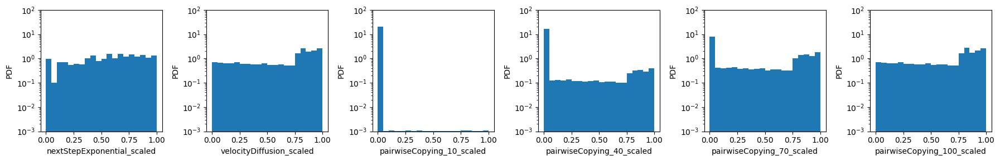

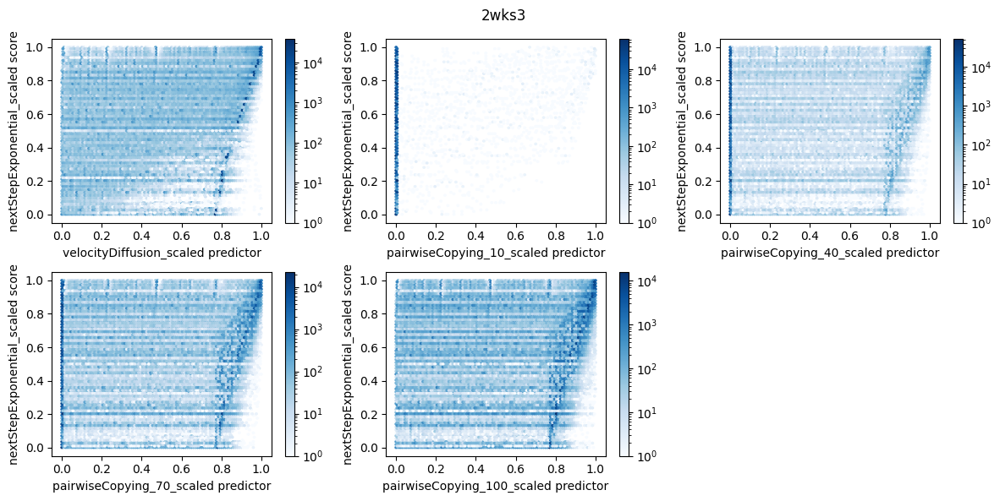

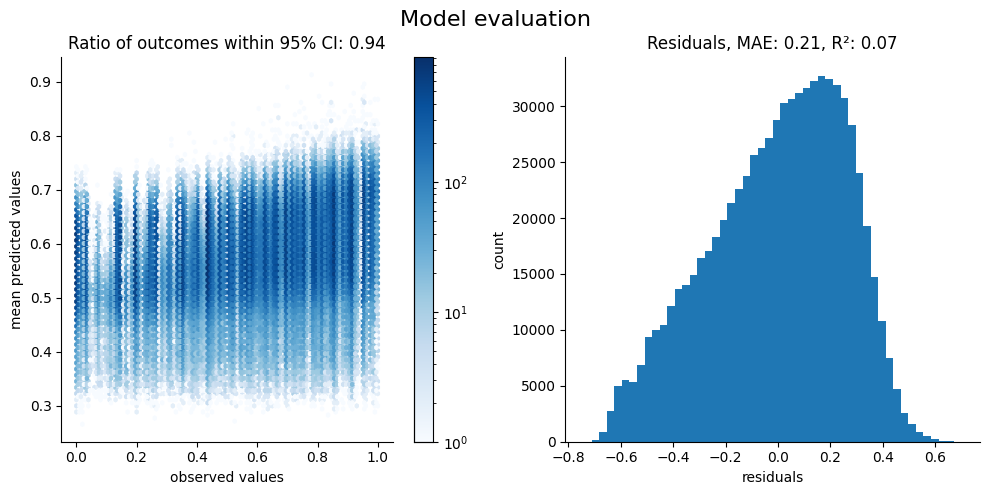

--------------------------------------------------
Starting analysis of experiment: 2wks4
--------------------------------------------------
original_frames: 35734
original_shape: (71468, 4)
resulting_frames: 3574
resulting_shape: (7148, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 19:46:42,220 - Local windows completed in 38.33 seconds.
2024-10-11 19:47:10,232 - velocityDiffusion completed in 28.01 seconds.
2024-10-11 19:47:47,400 - pairwiseCopying_10 completed in 37.17 seconds.
2024-10-11 19:48:31,446 - pairwiseCopying_40 completed in 44.04 seconds.
2024-10-11 19:49:22,107 - pairwiseCopying_70 completed in 50.66 seconds.
2024-10-11 19:50:16,694 - pairwiseCopying_100 completed in 54.59 seconds.
2024-10-11 19:50:30,740 - nextStepExponential completed in 14.04 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: User

Fraction of frames with both fish present : 0.7302742025741467


2024-10-11 19:52:03,624 - Starting SVI inference with 1000 iterations.
2024-10-11 19:52:03,872 - Step 0, elbo loss: 423310.93677723396
2024-10-11 19:52:33,657 - Step 200, elbo loss: 148624.6573565304
2024-10-11 19:53:02,831 - Step 400, elbo loss: 138000.54624822235
2024-10-11 19:53:35,716 - Step 600, elbo loss: 245190.42765671687
2024-10-11 19:54:05,984 - Step 800, elbo loss: 105715.2968117613
2024-10-11 19:54:35,780 - SVI inference completed in 152.15 seconds.


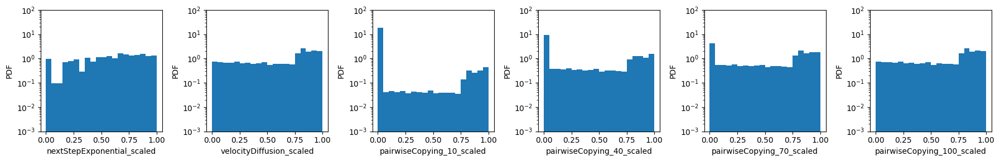

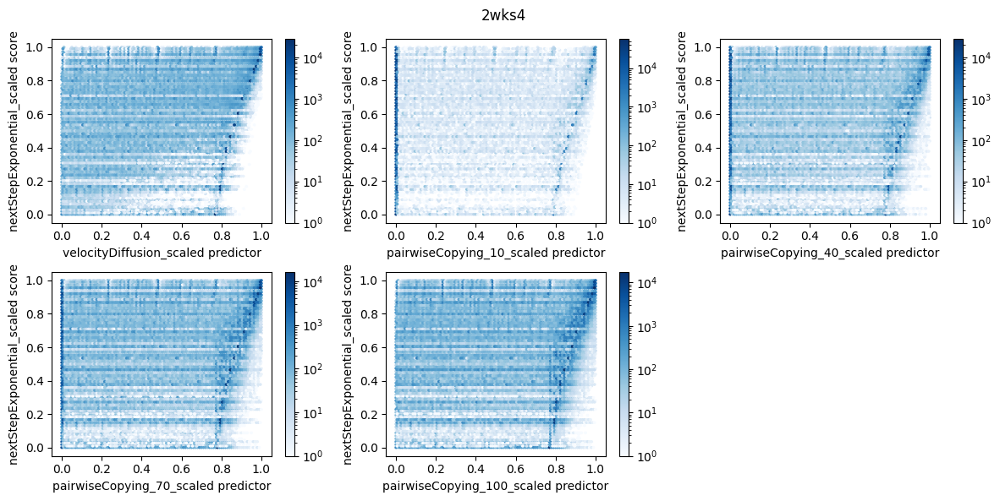

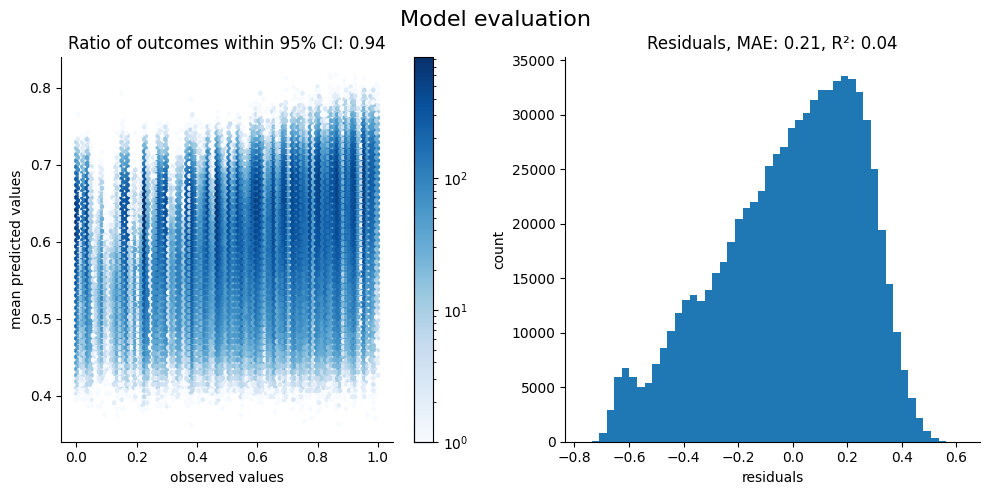

--------------------------------------------------
Starting analysis of experiment: 2wks5
--------------------------------------------------
original_frames: 35293
original_shape: (70586, 4)
resulting_frames: 3530
resulting_shape: (7060, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 19:56:20,556 - Local windows completed in 25.09 seconds.
2024-10-11 19:56:42,164 - velocityDiffusion completed in 21.61 seconds.
2024-10-11 19:57:04,635 - pairwiseCopying_10 completed in 22.47 seconds.
2024-10-11 19:57:38,692 - pairwiseCopying_40 completed in 34.06 seconds.
2024-10-11 19:58:16,059 - pairwiseCopying_70 completed in 37.37 seconds.
2024-10-11 19:58:53,042 - pairwiseCopying_100 completed in 36.98 seconds.
2024-10-11 19:58:59,799 - nextStepExponential completed in 6.76 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.5226628895184136


2024-10-11 20:00:02,230 - Starting SVI inference with 1000 iterations.
2024-10-11 20:00:02,390 - Step 0, elbo loss: 305210.9356933429
2024-10-11 20:00:23,492 - Step 200, elbo loss: 159325.46665636468
2024-10-11 20:00:44,210 - Step 400, elbo loss: 119736.8433163967
2024-10-11 20:01:05,270 - Step 600, elbo loss: 104680.03877192031
2024-10-11 20:01:25,934 - Step 800, elbo loss: 106683.49079269056
2024-10-11 20:01:46,734 - SVI inference completed in 104.50 seconds.


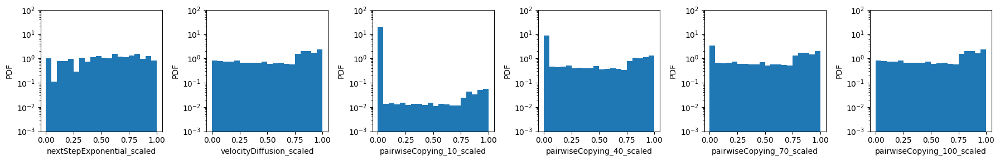

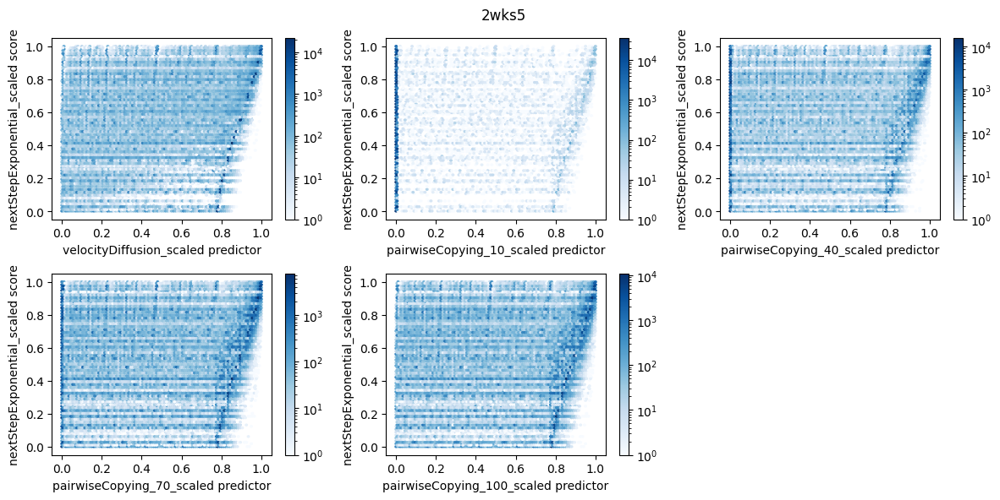

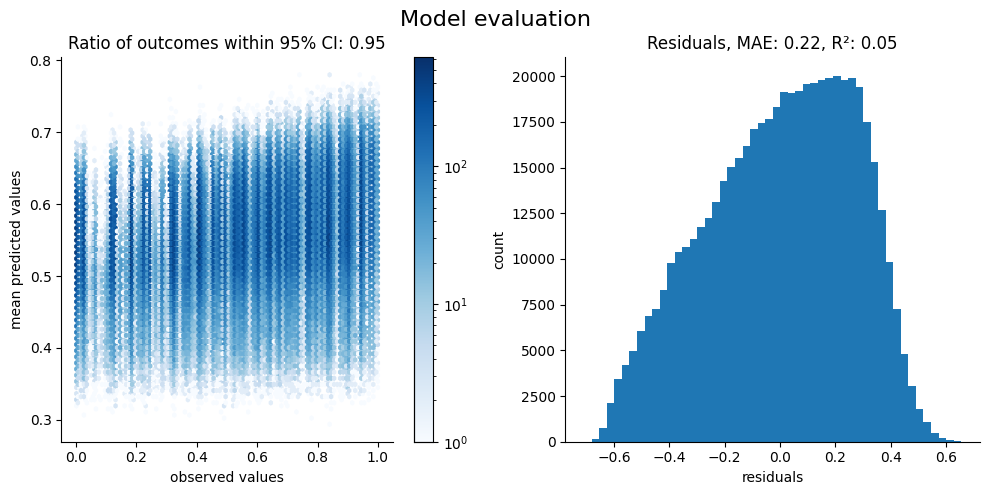

--------------------------------------------------
Starting analysis of experiment: 2wks6
--------------------------------------------------
original_frames: 35677
original_shape: (71354, 4)
resulting_frames: 3568
resulting_shape: (7136, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 20:03:11,394 - Local windows completed in 30.70 seconds.
2024-10-11 20:03:32,553 - velocityDiffusion completed in 21.16 seconds.
2024-10-11 20:04:00,979 - pairwiseCopying_10 completed in 28.43 seconds.
2024-10-11 20:04:34,413 - pairwiseCopying_40 completed in 33.43 seconds.
2024-10-11 20:05:17,169 - pairwiseCopying_70 completed in 42.76 seconds.
2024-10-11 20:06:05,240 - pairwiseCopying_100 completed in 48.07 seconds.
2024-10-11 20:06:14,250 - nextStepExponential completed in 9.01 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.6768497757847534


2024-10-11 20:07:36,135 - Starting SVI inference with 1000 iterations.
2024-10-11 20:07:36,329 - Step 0, elbo loss: 628105.9570965735
2024-10-11 20:08:01,666 - Step 200, elbo loss: 282276.31936741644
2024-10-11 20:08:26,995 - Step 400, elbo loss: 179475.6650234004
2024-10-11 20:08:52,451 - Step 600, elbo loss: 130972.7250928607
2024-10-11 20:09:17,978 - Step 800, elbo loss: 136076.62196148658
2024-10-11 20:09:43,657 - SVI inference completed in 127.52 seconds.


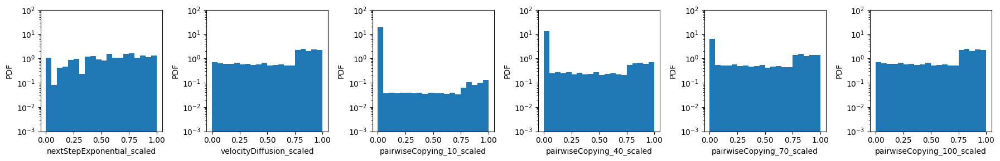

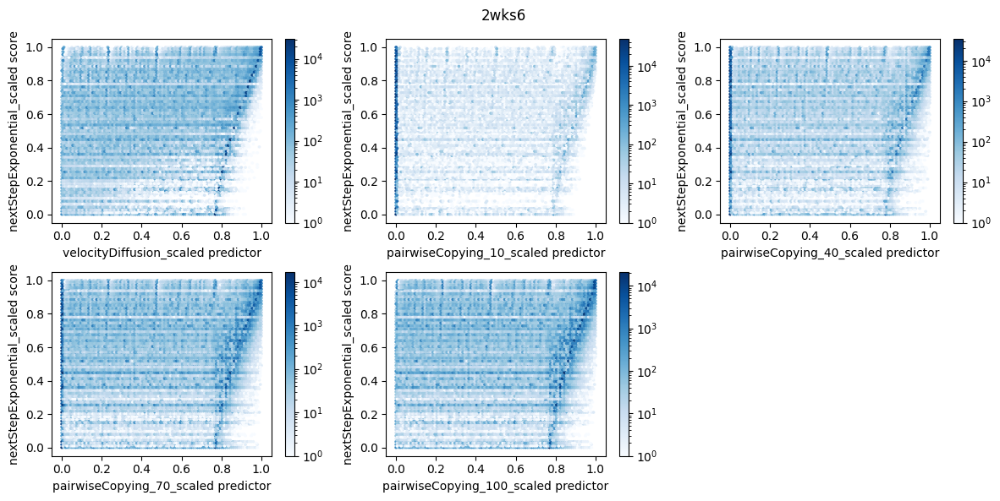

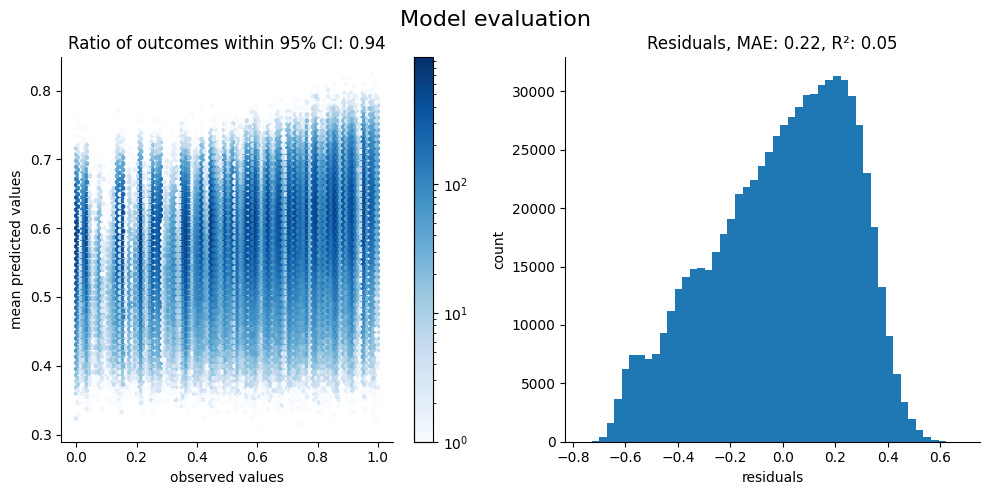

--------------------------------------------------
Starting analysis of experiment: 2wks7
--------------------------------------------------
original_frames: 35437
original_shape: (70874, 4)
resulting_frames: 3544
resulting_shape: (7088, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 20:11:33,254 - Local windows completed in 26.04 seconds.
2024-10-11 20:11:49,379 - velocityDiffusion completed in 16.12 seconds.
2024-10-11 20:12:13,594 - pairwiseCopying_10 completed in 24.21 seconds.
2024-10-11 20:12:45,897 - pairwiseCopying_40 completed in 32.30 seconds.
2024-10-11 20:13:22,726 - pairwiseCopying_70 completed in 36.83 seconds.
2024-10-11 20:14:00,913 - pairwiseCopying_100 completed in 38.19 seconds.
2024-10-11 20:14:08,046 - nextStepExponential completed in 7.13 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.5045146726862303


2024-10-11 20:15:11,709 - Starting SVI inference with 1000 iterations.
2024-10-11 20:15:11,889 - Step 0, elbo loss: 279926.2535257753
2024-10-11 20:15:32,700 - Step 200, elbo loss: 197204.90350348802
2024-10-11 20:15:53,599 - Step 400, elbo loss: 117116.60207454635
2024-10-11 20:16:14,347 - Step 600, elbo loss: 97715.62399500291
2024-10-11 20:16:35,154 - Step 800, elbo loss: 91156.9422756496
2024-10-11 20:16:56,140 - SVI inference completed in 104.43 seconds.


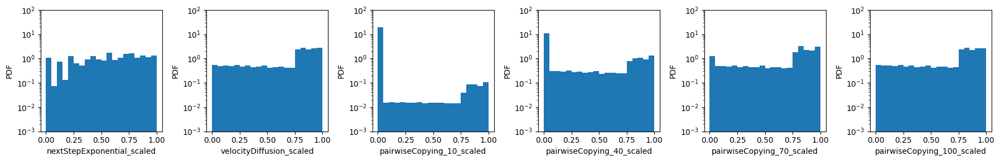

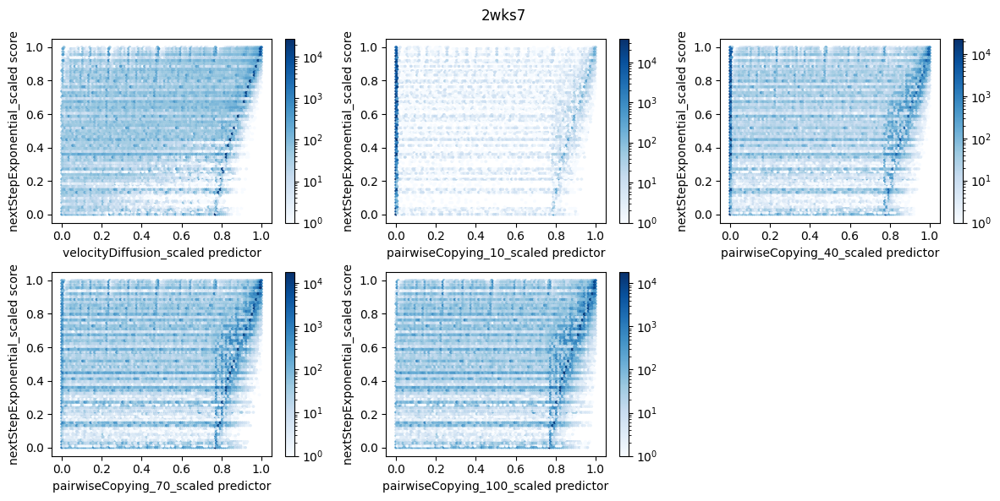

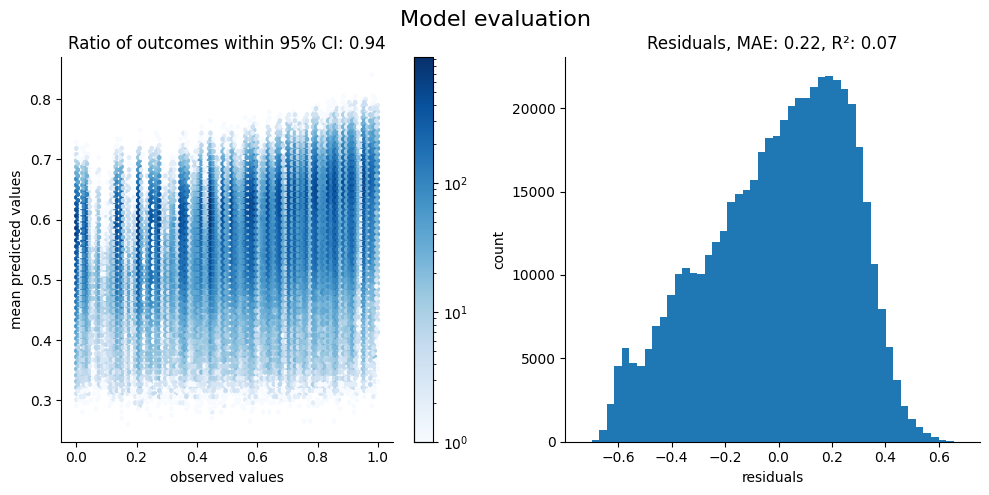

--------------------------------------------------
Starting analysis of experiment: 4wks0
--------------------------------------------------
original_frames: 35634
original_shape: (71268, 4)
resulting_frames: 3564
resulting_shape: (7128, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 20:18:06,989 - Local windows completed in 13.94 seconds.
2024-10-11 20:18:17,120 - velocityDiffusion completed in 10.13 seconds.
2024-10-11 20:18:28,097 - pairwiseCopying_10 completed in 10.98 seconds.
2024-10-11 20:18:46,883 - pairwiseCopying_40 completed in 18.79 seconds.
2024-10-11 20:19:06,109 - pairwiseCopying_70 completed in 19.23 seconds.
2024-10-11 20:19:25,824 - pairwiseCopying_100 completed in 19.71 seconds.
2024-10-11 20:19:29,314 - nextStepExponential completed in 3.49 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.239337822671156


2024-10-11 20:19:56,081 - Starting SVI inference with 1000 iterations.
2024-10-11 20:19:56,163 - Step 0, elbo loss: 129511.10462527262
2024-10-11 20:20:04,203 - Step 200, elbo loss: 45272.76007812866
2024-10-11 20:20:11,889 - Step 400, elbo loss: 38671.24667324466
2024-10-11 20:20:20,433 - Step 600, elbo loss: 46321.5004322766
2024-10-11 20:20:28,613 - Step 800, elbo loss: 35257.98919007251
2024-10-11 20:20:37,879 - SVI inference completed in 41.80 seconds.


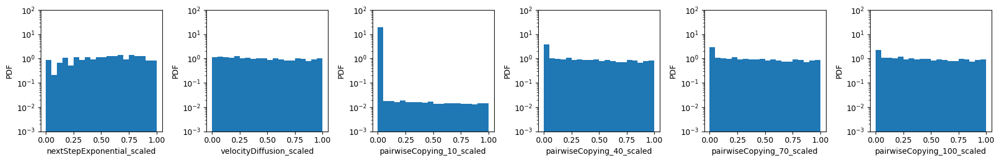

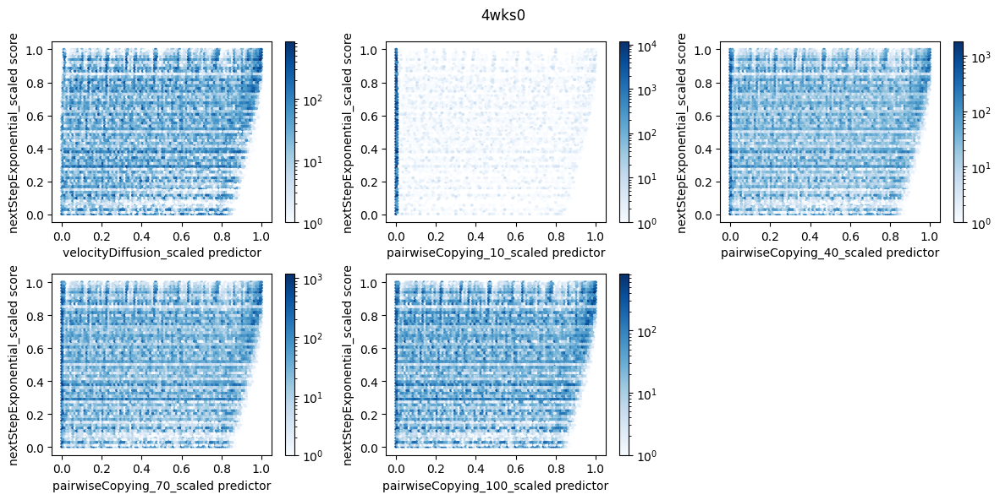

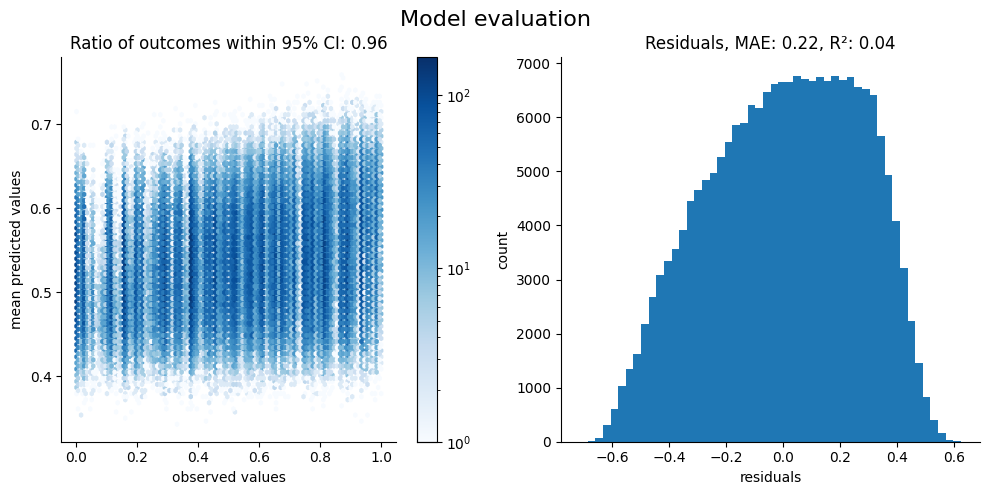

--------------------------------------------------
Starting analysis of experiment: 4wks1
--------------------------------------------------
original_frames: 35273
original_shape: (70546, 4)
resulting_frames: 3528
resulting_shape: (7056, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 20:21:51,475 - Local windows completed in 49.05 seconds.
2024-10-11 20:22:26,285 - velocityDiffusion completed in 34.81 seconds.
2024-10-11 20:23:03,278 - pairwiseCopying_10 completed in 36.99 seconds.
2024-10-11 20:23:42,163 - pairwiseCopying_40 completed in 38.88 seconds.
2024-10-11 20:24:25,862 - pairwiseCopying_70 completed in 43.70 seconds.
2024-10-11 20:25:22,705 - pairwiseCopying_100 completed in 56.84 seconds.
2024-10-11 20:25:37,456 - nextStepExponential completed in 14.75 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: User

Fraction of frames with both fish present : 0.8330498866213152


2024-10-11 20:27:30,979 - Starting SVI inference with 1000 iterations.
2024-10-11 20:27:31,906 - Step 0, elbo loss: 438120.841545941
2024-10-11 20:28:10,974 - Step 200, elbo loss: 236906.56190524797
2024-10-11 20:28:47,051 - Step 400, elbo loss: 264280.8385093534
2024-10-11 20:29:25,974 - Step 600, elbo loss: 172304.9701926821
2024-10-11 20:30:02,276 - Step 800, elbo loss: 174408.70756879574
2024-10-11 20:30:38,397 - SVI inference completed in 187.42 seconds.


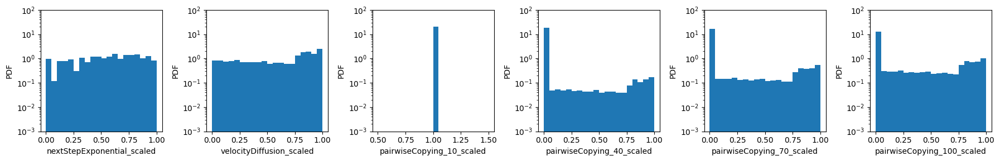

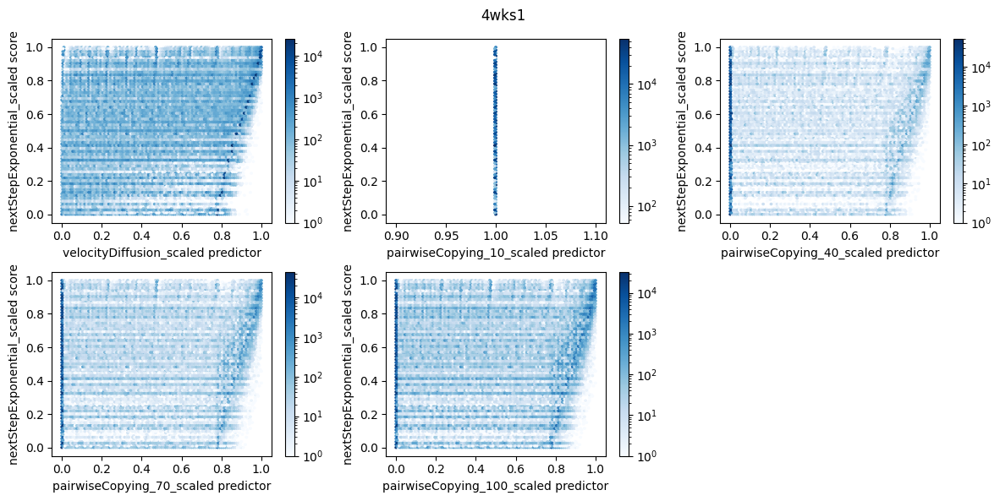

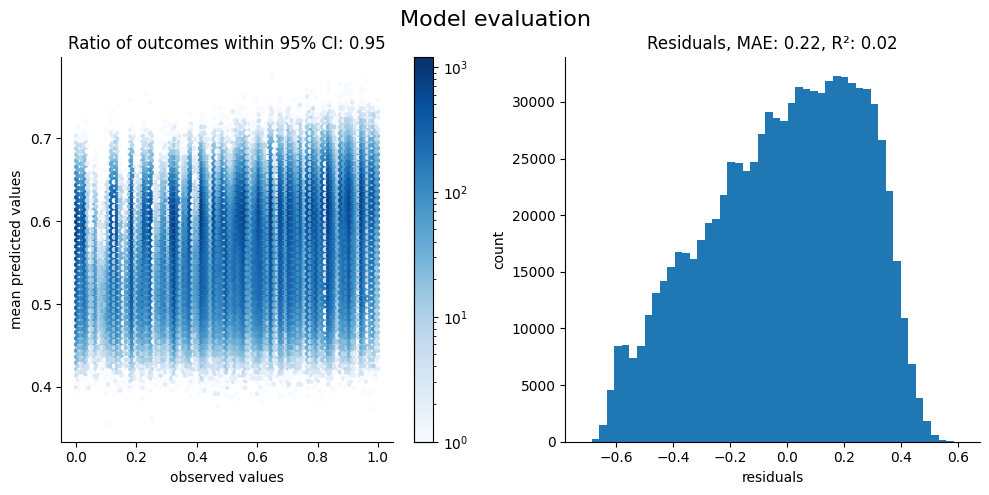

--------------------------------------------------
Starting analysis of experiment: 4wks2
--------------------------------------------------
original_frames: 35253
original_shape: (70506, 4)
resulting_frames: 3526
resulting_shape: (7052, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 20:33:02,420 - Local windows completed in 50.35 seconds.
2024-10-11 20:33:35,079 - velocityDiffusion completed in 32.66 seconds.
2024-10-11 20:34:13,864 - pairwiseCopying_10 completed in 38.78 seconds.
2024-10-11 20:35:03,693 - pairwiseCopying_40 completed in 49.83 seconds.
2024-10-11 20:36:02,795 - pairwiseCopying_70 completed in 59.10 seconds.
2024-10-11 20:37:14,302 - pairwiseCopying_100 completed in 71.51 seconds.
2024-10-11 20:37:28,001 - nextStepExponential completed in 13.70 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: User

Fraction of frames with both fish present : 0.9509359047078842


2024-10-11 20:39:37,233 - Starting SVI inference with 1000 iterations.
2024-10-11 20:39:37,663 - Step 0, elbo loss: 688395.3197567934
2024-10-11 20:40:27,902 - Step 200, elbo loss: 301504.1085427501
2024-10-11 20:41:12,314 - Step 400, elbo loss: 279228.6375891398
2024-10-11 20:41:59,000 - Step 600, elbo loss: 321512.15246972337
2024-10-11 20:42:41,638 - Step 800, elbo loss: 268513.52167912334
2024-10-11 20:43:25,903 - SVI inference completed in 228.67 seconds.


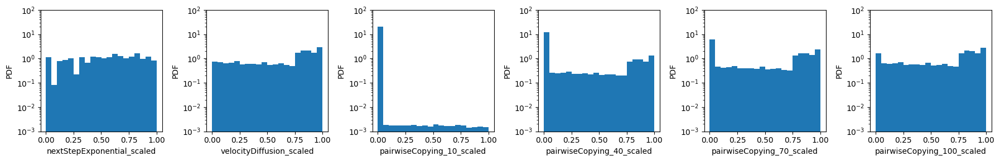

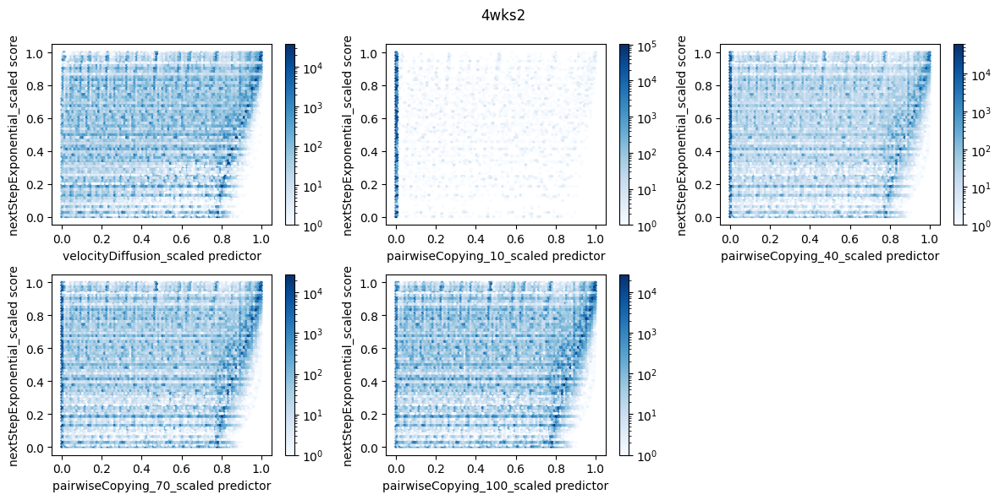

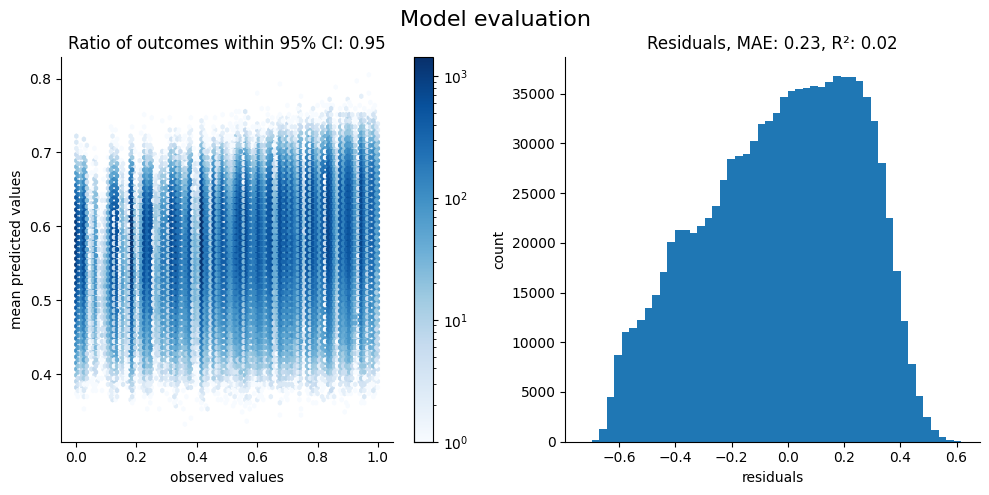

--------------------------------------------------
Starting analysis of experiment: 4wks3
--------------------------------------------------
original_frames: 35352
original_shape: (70704, 4)
resulting_frames: 3536
resulting_shape: (7072, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 20:45:51,242 - Local windows completed in 13.11 seconds.
2024-10-11 20:46:00,214 - velocityDiffusion completed in 8.97 seconds.
2024-10-11 20:46:10,365 - pairwiseCopying_10 completed in 10.15 seconds.
2024-10-11 20:46:20,571 - pairwiseCopying_40 completed in 10.21 seconds.
2024-10-11 20:46:30,449 - pairwiseCopying_70 completed in 9.88 seconds.
2024-10-11 20:46:41,421 - pairwiseCopying_100 completed in 10.97 seconds.
2024-10-11 20:46:44,660 - nextStepExponential completed in 3.24 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserWar

Fraction of frames with both fish present : 0.21747737556561086


2024-10-11 20:47:13,368 - Starting SVI inference with 1000 iterations.
2024-10-11 20:47:13,451 - Step 0, elbo loss: 83998.21258754874
2024-10-11 20:47:22,422 - Step 200, elbo loss: 130857.48157125576
2024-10-11 20:47:31,901 - Step 400, elbo loss: 48538.356629067115
2024-10-11 20:47:40,626 - Step 600, elbo loss: 43820.843776378206
2024-10-11 20:47:49,454 - Step 800, elbo loss: 47727.84757945063
2024-10-11 20:47:58,415 - SVI inference completed in 45.05 seconds.


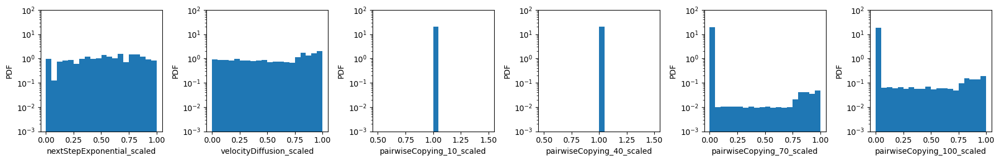

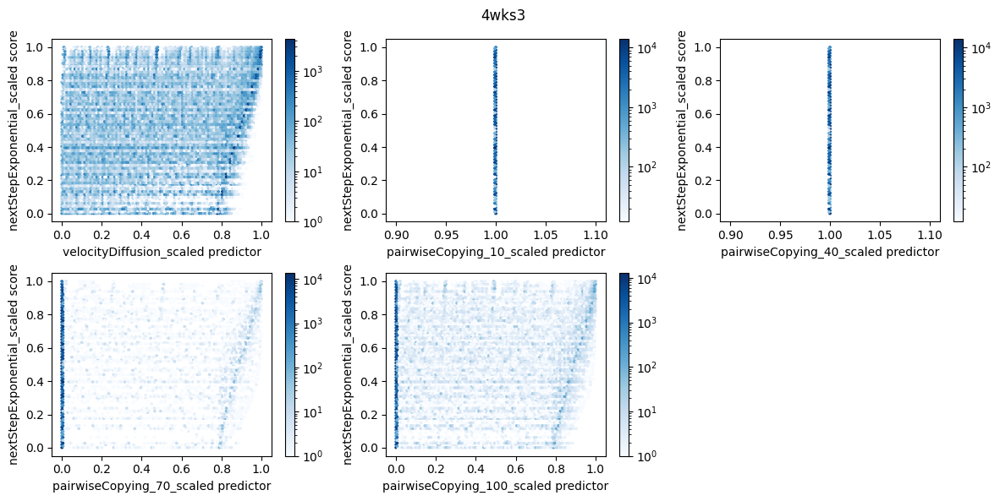

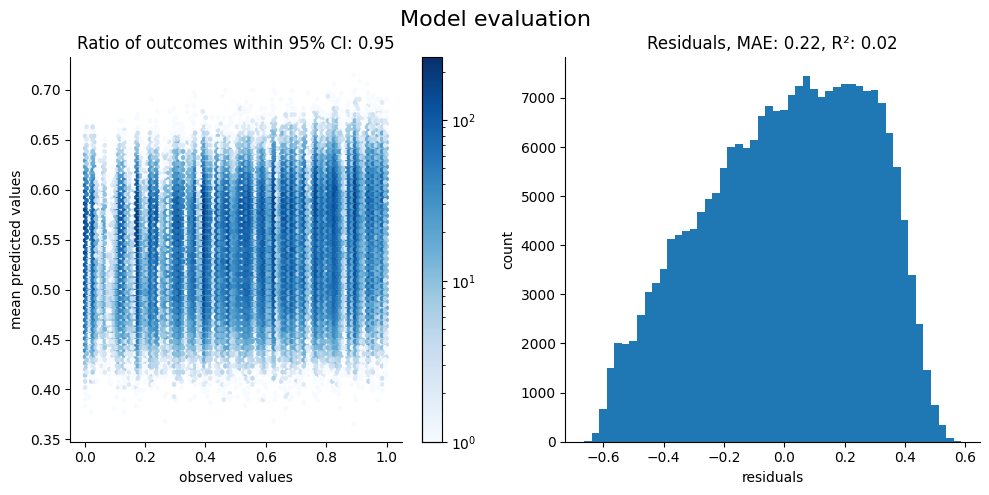

--------------------------------------------------
Starting analysis of experiment: 4wks5
--------------------------------------------------
original_frames: 35379
original_shape: (70758, 4)
resulting_frames: 3538
resulting_shape: (7076, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 20:48:58,543 - Local windows completed in 34.92 seconds.
2024-10-11 20:49:25,373 - velocityDiffusion completed in 26.83 seconds.
2024-10-11 20:49:53,333 - pairwiseCopying_10 completed in 27.96 seconds.
2024-10-11 20:50:31,365 - pairwiseCopying_40 completed in 38.03 seconds.
2024-10-11 20:51:12,161 - pairwiseCopying_70 completed in 40.80 seconds.
2024-10-11 20:51:58,986 - pairwiseCopying_100 completed in 46.82 seconds.
2024-10-11 20:52:08,408 - nextStepExponential completed in 9.42 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.6630864895421142


2024-10-11 20:53:37,041 - Starting SVI inference with 1000 iterations.
2024-10-11 20:53:37,280 - Step 0, elbo loss: 902748.6232234307
2024-10-11 20:54:02,698 - Step 200, elbo loss: 170613.3481278863
2024-10-11 20:54:33,881 - Step 400, elbo loss: 118068.53767391108
2024-10-11 20:55:03,831 - Step 600, elbo loss: 109583.501003923
2024-10-11 20:55:33,833 - Step 800, elbo loss: 119351.36136303344
2024-10-11 20:56:03,470 - SVI inference completed in 146.43 seconds.


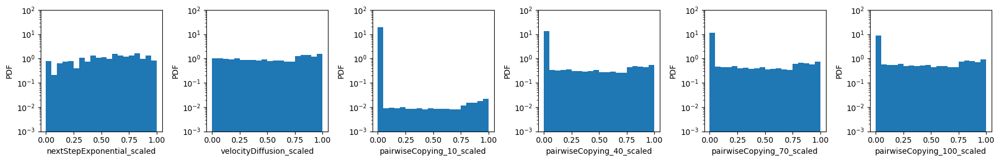

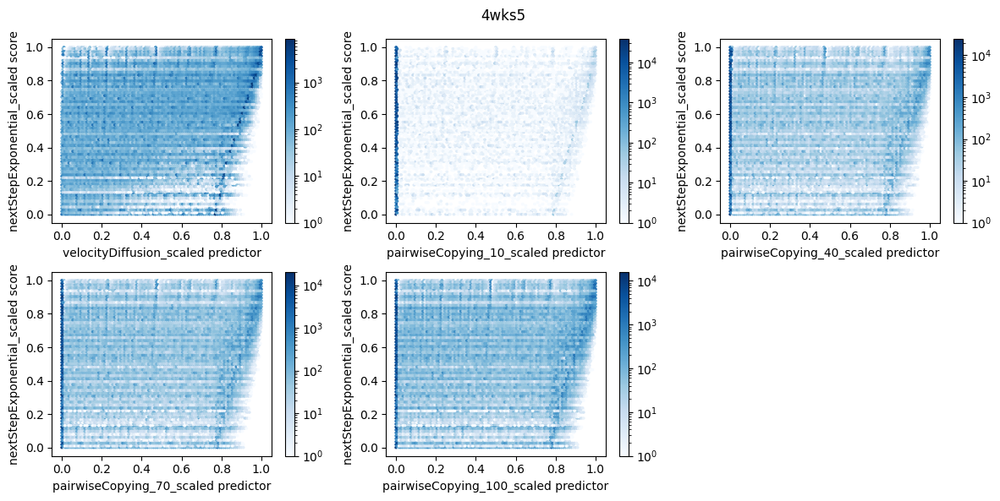

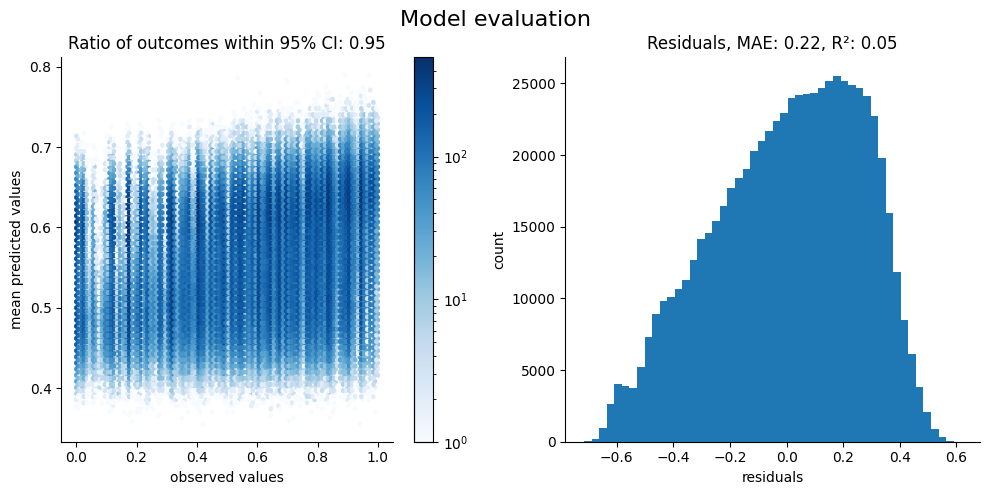

--------------------------------------------------
Starting analysis of experiment: 4wks6
--------------------------------------------------
original_frames: 30536
original_shape: (61072, 4)
resulting_frames: 3054
resulting_shape: (6108, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 20:57:55,142 - Local windows completed in 25.99 seconds.
2024-10-11 20:58:13,243 - velocityDiffusion completed in 18.10 seconds.
2024-10-11 20:58:32,431 - pairwiseCopying_10 completed in 19.19 seconds.
2024-10-11 20:58:54,665 - pairwiseCopying_40 completed in 22.23 seconds.
2024-10-11 20:59:17,859 - pairwiseCopying_70 completed in 23.19 seconds.
2024-10-11 20:59:43,894 - pairwiseCopying_100 completed in 26.03 seconds.
2024-10-11 20:59:49,863 - nextStepExponential completed in 5.97 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.4623444662737394


2024-10-11 21:00:40,398 - Starting SVI inference with 1000 iterations.
2024-10-11 21:00:40,591 - Step 0, elbo loss: 428908.62559325487
2024-10-11 21:01:00,222 - Step 200, elbo loss: 90569.21623463262
2024-10-11 21:01:19,320 - Step 400, elbo loss: 73512.44476415869
2024-10-11 21:01:38,574 - Step 600, elbo loss: 62222.78843847534
2024-10-11 21:01:58,674 - Step 800, elbo loss: 62629.427101068286
2024-10-11 21:02:25,300 - SVI inference completed in 104.90 seconds.


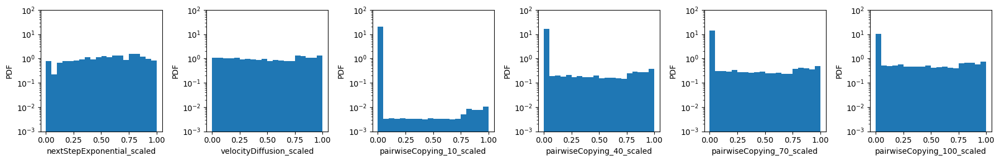

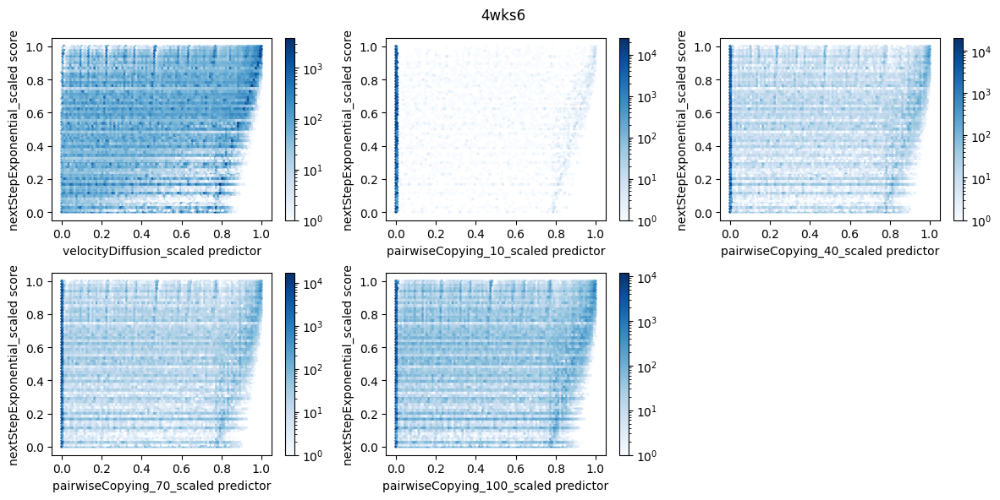

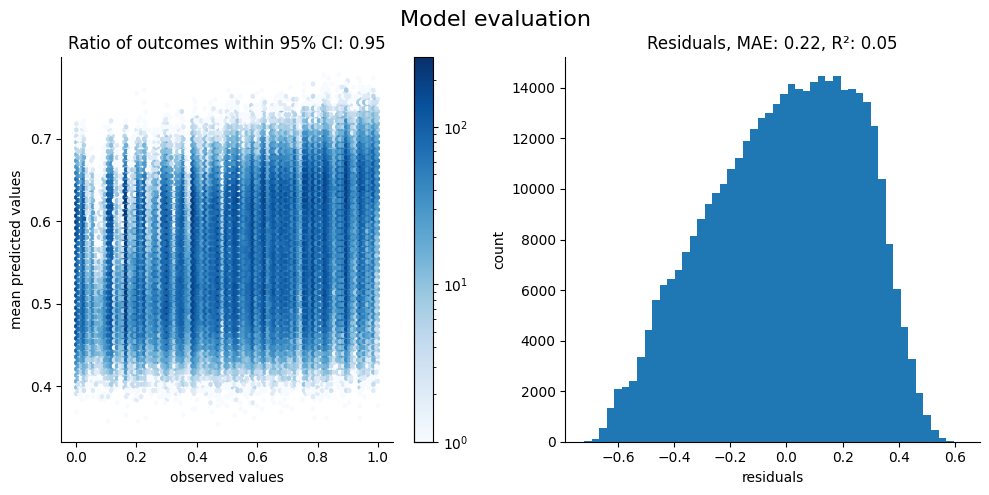

--------------------------------------------------
Starting analysis of experiment: 4wks7
--------------------------------------------------
original_frames: 35952
original_shape: (71904, 4)
resulting_frames: 3596
resulting_shape: (7192, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 21:03:43,540 - Local windows completed in 24.44 seconds.
2024-10-11 21:04:04,559 - velocityDiffusion completed in 21.02 seconds.
2024-10-11 21:04:26,171 - pairwiseCopying_10 completed in 21.61 seconds.
2024-10-11 21:04:55,145 - pairwiseCopying_40 completed in 28.97 seconds.
2024-10-11 21:05:27,798 - pairwiseCopying_70 completed in 32.65 seconds.
2024-10-11 21:06:05,028 - pairwiseCopying_100 completed in 37.23 seconds.
2024-10-11 21:06:12,489 - nextStepExponential completed in 7.46 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.3743047830923248


2024-10-11 21:07:09,529 - Starting SVI inference with 1000 iterations.
2024-10-11 21:07:10,029 - Step 0, elbo loss: 1176327.6765893372
2024-10-11 21:07:34,020 - Step 200, elbo loss: 102188.44022206898
2024-10-11 21:07:57,009 - Step 400, elbo loss: 79671.1590245954
2024-10-11 21:08:22,433 - Step 600, elbo loss: 55142.58101179748
2024-10-11 21:08:48,597 - Step 800, elbo loss: 60452.57678214203
2024-10-11 21:09:16,837 - SVI inference completed in 127.31 seconds.


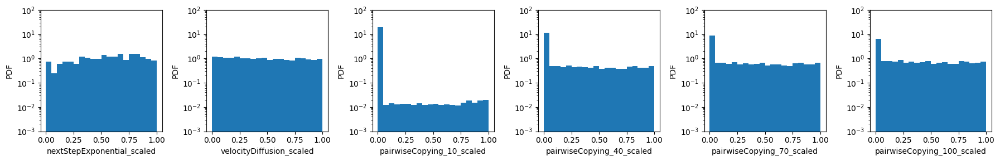

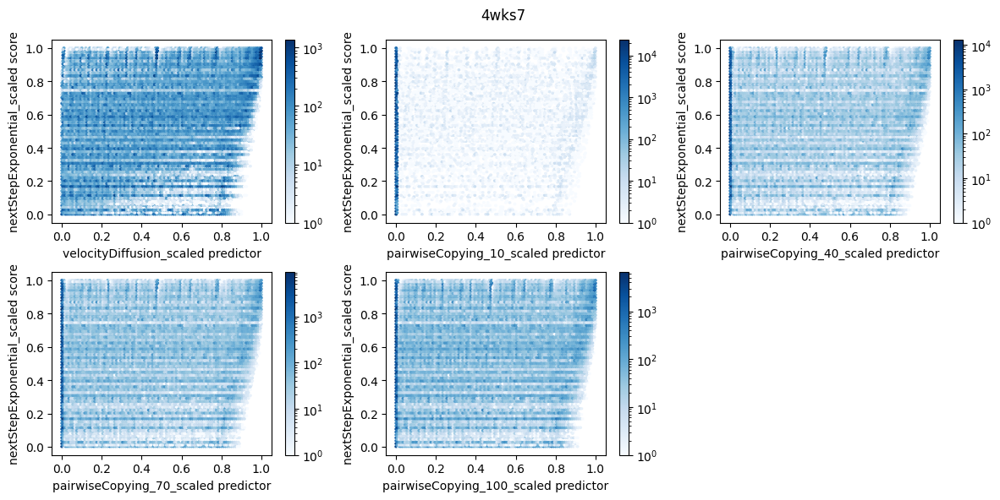

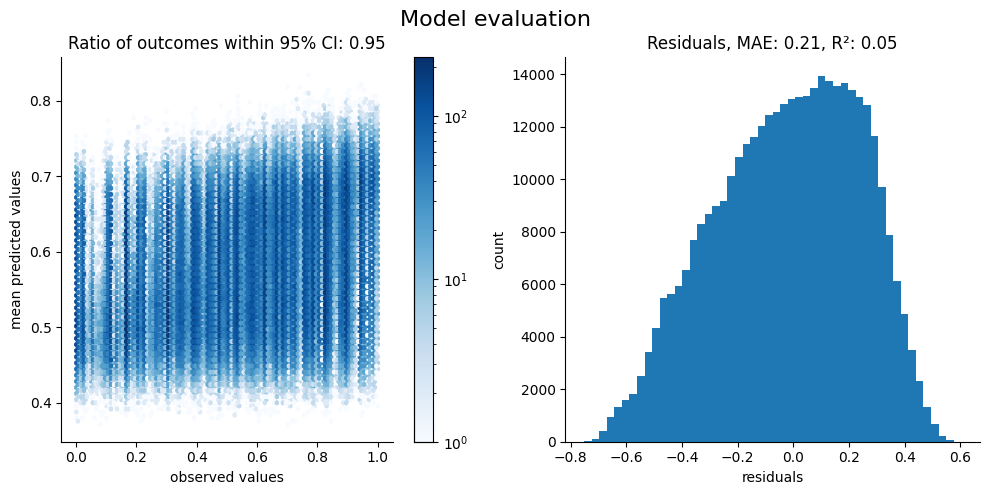

--------------------------------------------------
Starting analysis of experiment: 6wks0
--------------------------------------------------
original_frames: 34739
original_shape: (69478, 4)
resulting_frames: 3474
resulting_shape: (6948, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 21:10:41,872 - Local windows completed in 31.45 seconds.
2024-10-11 21:11:10,592 - velocityDiffusion completed in 28.72 seconds.
2024-10-11 21:11:37,563 - pairwiseCopying_10 completed in 26.97 seconds.
2024-10-11 21:12:26,053 - pairwiseCopying_40 completed in 48.49 seconds.
2024-10-11 21:13:08,495 - pairwiseCopying_70 completed in 42.44 seconds.
2024-10-11 21:13:49,991 - pairwiseCopying_100 completed in 41.50 seconds.
2024-10-11 21:13:58,439 - nextStepExponential completed in 8.45 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.44041450777202074


2024-10-11 21:14:52,037 - Starting SVI inference with 1000 iterations.
2024-10-11 21:14:52,544 - Step 0, elbo loss: 323308.7891244906
2024-10-11 21:15:10,935 - Step 200, elbo loss: 111495.91100948982
2024-10-11 21:15:29,528 - Step 400, elbo loss: -19223.402433347263
2024-10-11 21:15:48,018 - Step 600, elbo loss: -66166.53955189648
2024-10-11 21:16:07,908 - Step 800, elbo loss: -65258.00401893076
2024-10-11 21:16:32,044 - SVI inference completed in 100.01 seconds.


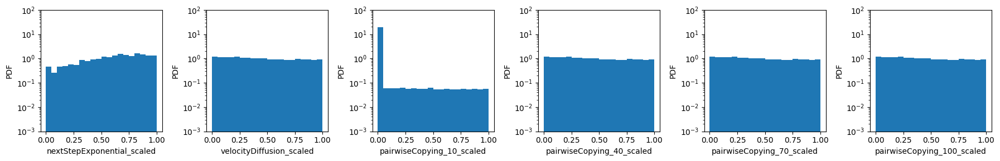

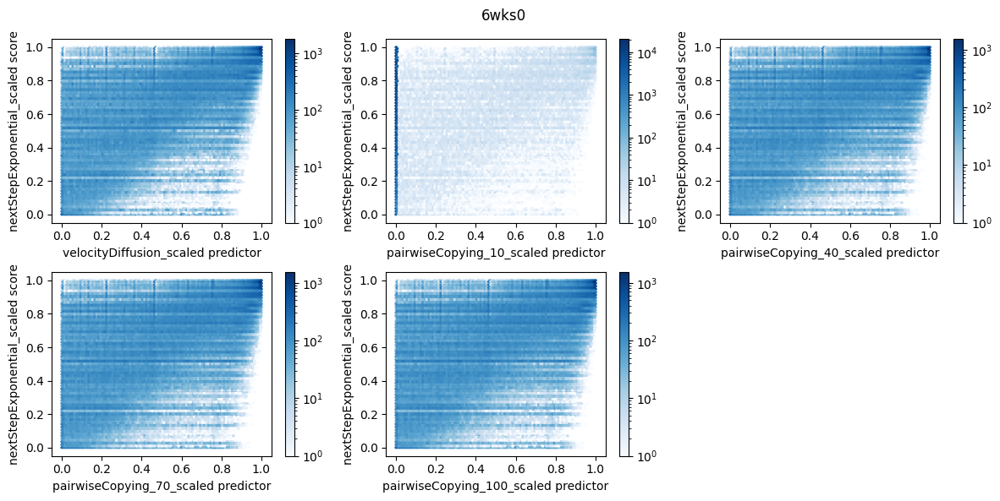

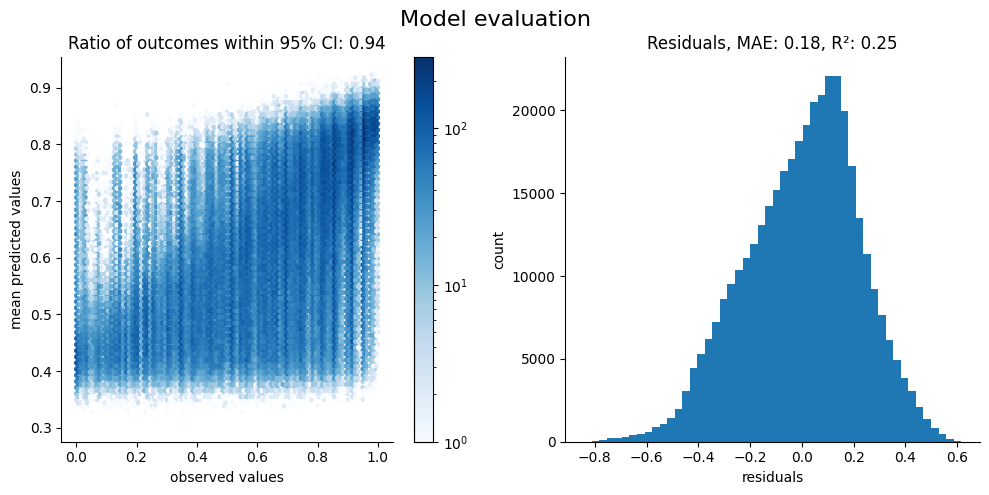

--------------------------------------------------
Starting analysis of experiment: 6wks1
--------------------------------------------------
original_frames: 35924
original_shape: (71848, 4)
resulting_frames: 3593
resulting_shape: (7186, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 21:18:29,237 - Local windows completed in 44.59 seconds.
2024-10-11 21:19:03,947 - velocityDiffusion completed in 34.71 seconds.
2024-10-11 21:19:38,176 - pairwiseCopying_10 completed in 34.23 seconds.
2024-10-11 21:20:31,508 - pairwiseCopying_40 completed in 53.33 seconds.
2024-10-11 21:21:26,211 - pairwiseCopying_70 completed in 54.70 seconds.
2024-10-11 21:22:22,853 - pairwiseCopying_100 completed in 56.64 seconds.
2024-10-11 21:22:33,695 - nextStepExponential completed in 10.84 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: User

Fraction of frames with both fish present : 0.4962426941274701


2024-10-11 21:23:52,246 - Starting SVI inference with 1000 iterations.
2024-10-11 21:23:53,082 - Step 0, elbo loss: 441757.5071259435
2024-10-11 21:24:18,951 - Step 200, elbo loss: 47233.69250867002
2024-10-11 21:24:47,147 - Step 400, elbo loss: -46245.58681629479
2024-10-11 21:25:13,163 - Step 600, elbo loss: -71075.25567470718
2024-10-11 21:25:37,664 - Step 800, elbo loss: -79798.94973849677
2024-10-11 21:26:03,787 - SVI inference completed in 131.54 seconds.


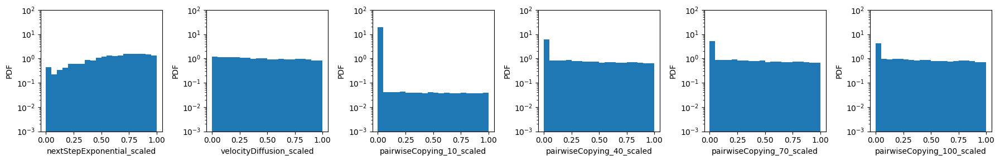

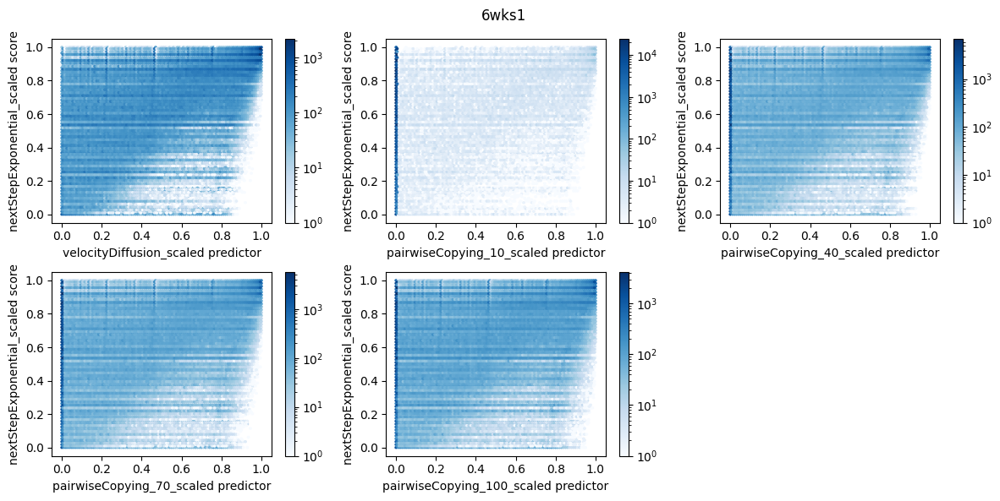

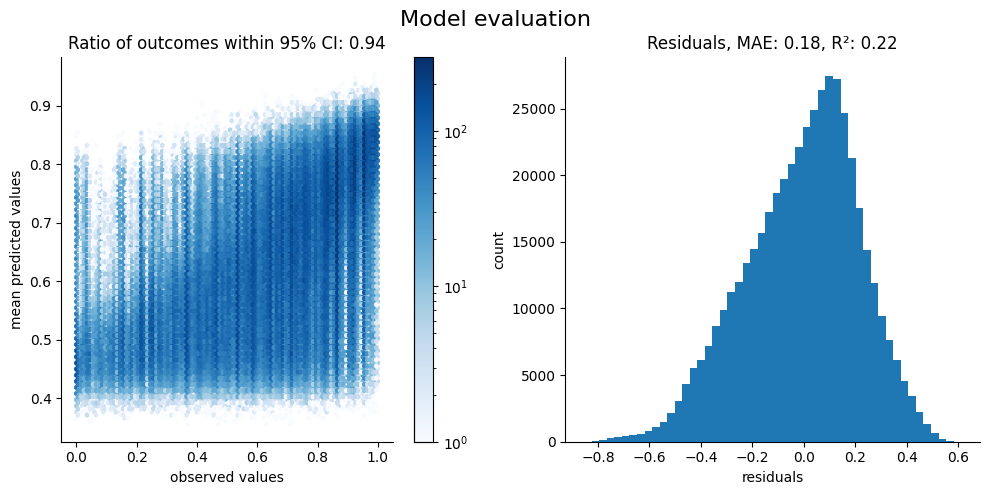

--------------------------------------------------
Starting analysis of experiment: 6wks2
--------------------------------------------------
original_frames: 35259
original_shape: (70518, 4)
resulting_frames: 3526
resulting_shape: (7052, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 21:27:38,146 - Local windows completed in 31.73 seconds.
2024-10-11 21:28:02,539 - velocityDiffusion completed in 24.39 seconds.
2024-10-11 21:28:31,072 - pairwiseCopying_10 completed in 28.53 seconds.
2024-10-11 21:29:12,402 - pairwiseCopying_40 completed in 41.33 seconds.
2024-10-11 21:29:49,915 - pairwiseCopying_70 completed in 37.51 seconds.
2024-10-11 21:30:35,569 - pairwiseCopying_100 completed in 45.65 seconds.
2024-10-11 21:30:43,807 - nextStepExponential completed in 8.24 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.43959160521837776


2024-10-11 21:31:43,013 - Starting SVI inference with 1000 iterations.
2024-10-11 21:31:43,519 - Step 0, elbo loss: 303233.1545584294
2024-10-11 21:32:06,997 - Step 200, elbo loss: -8990.16083503063
2024-10-11 21:32:29,238 - Step 400, elbo loss: -42169.18296893152
2024-10-11 21:32:50,121 - Step 600, elbo loss: -61363.18513004829
2024-10-11 21:33:11,409 - Step 800, elbo loss: -47844.21872761019
2024-10-11 21:33:39,370 - SVI inference completed in 116.36 seconds.


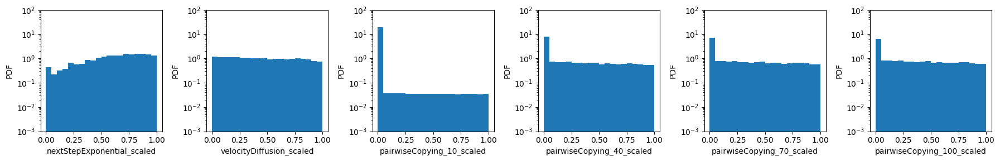

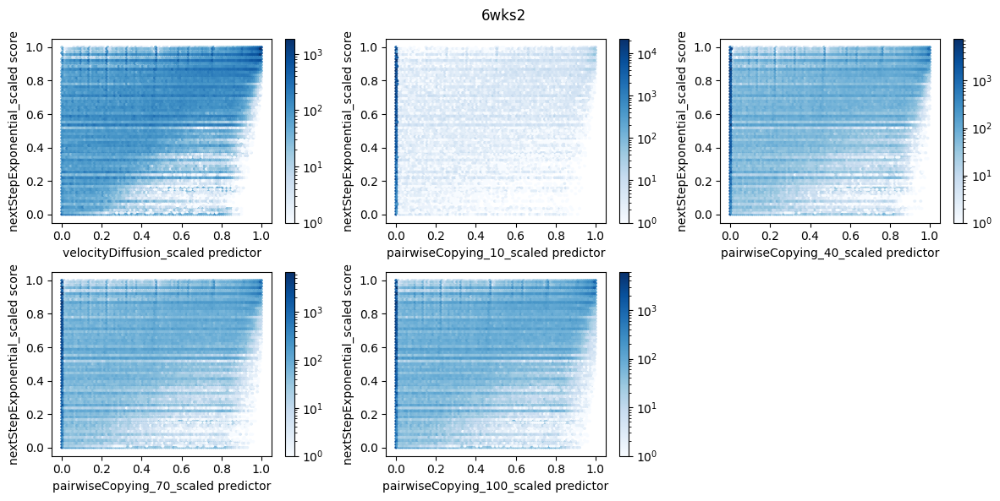

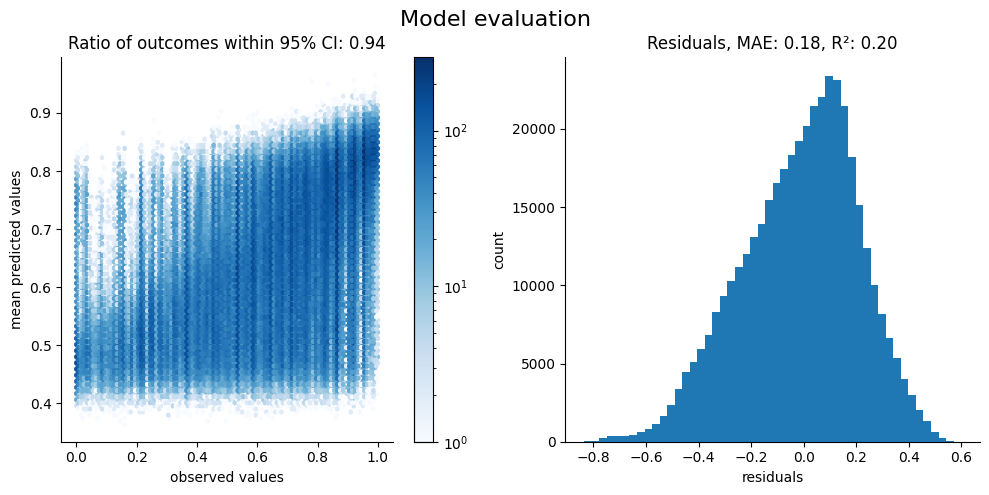

--------------------------------------------------
Starting analysis of experiment: 6wks4
--------------------------------------------------
original_frames: 25428
original_shape: (50856, 4)
resulting_frames: 2543
resulting_shape: (5086, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning:


                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                

2024-10-11 21:35:01,883 - Local windows completed in 23.41 seconds.
2024-10-11 21:35:23,481 - velocityDiffusion completed in 21.60 seconds.
2024-10-11 21:35:42,781 - pairwiseCopying_10 completed in 19.30 seconds.
2024-10-11 21:36:12,800 - pairwiseCopying_40 completed in 30.02 seconds.
2024-10-11 21:36:48,326 - pairwiseCopying_70 completed in 35.53 seconds.
2024-10-11 21:37:26,870 - pairwiseCopying_100 completed in 38.54 seconds.
2024-10-11 21:37:34,853 - nextStepExponential completed in 7.98 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/derive.py:64: UserW

Fraction of frames with both fish present : 0.49429807314195834


2024-10-11 21:38:28,650 - Starting SVI inference with 1000 iterations.
2024-10-11 21:38:29,077 - Step 0, elbo loss: 241770.5535430871
2024-10-11 21:38:47,466 - Step 200, elbo loss: -18322.22689391817
2024-10-11 21:39:06,361 - Step 400, elbo loss: -32136.637884282685
2024-10-11 21:39:24,937 - Step 600, elbo loss: -20285.505034305468
2024-10-11 21:39:43,478 - Step 800, elbo loss: -55846.22568837514
2024-10-11 21:40:01,691 - SVI inference completed in 93.04 seconds.


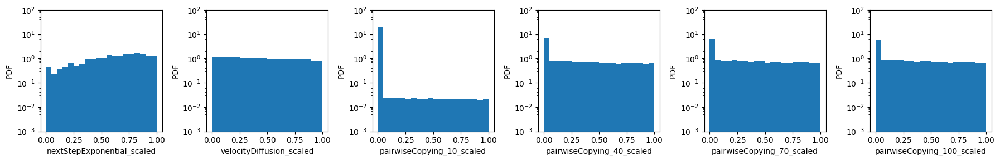

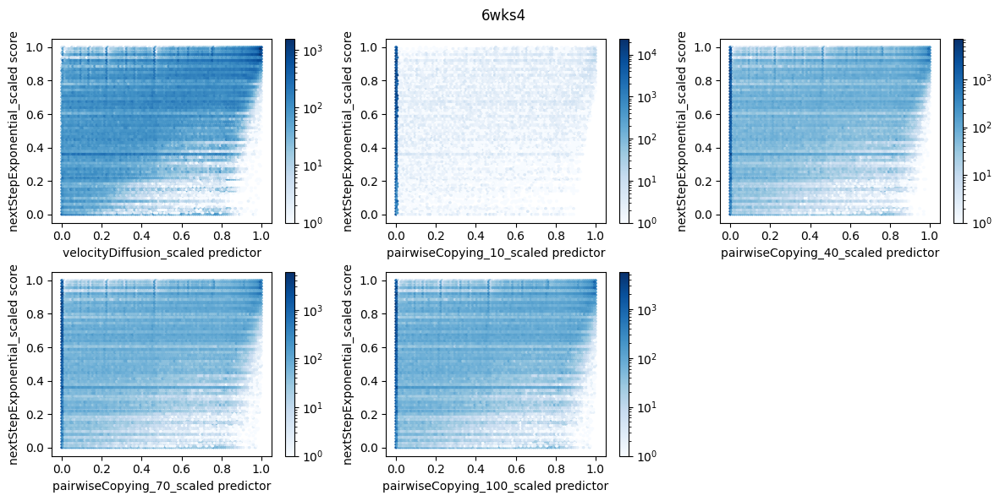

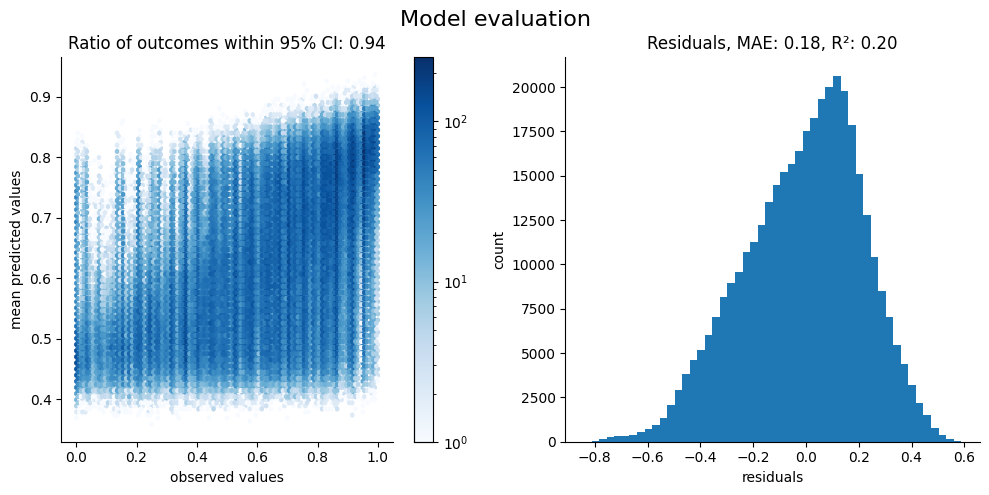

In [12]:
for i in range(len(exp_details)):
    exp = exp_details["experiment"][i]
    print("-"*50)
    print(f"Starting analysis of experiment: {exp}")
    print("-"*50)

    arena_size = int(exp_details["px_to_mm"][i]*1000)

    foragersDF = pd.read_csv(f"{folder_path}/{exp}.csv")
    grid_size = arena_size

    # scaling and subsampling
    foragersDF_scaled = rescale_to_grid(
        foragersDF, size=grid_size, gridMin=0, gridMax=arena_size
    )
    foragersDF_scaled_subsampled = subsample_frames_constant_frame_rate(foragersDF_scaled,frame_spacing=frames_skipped)

    # create foragers object
    foragers_object = dataObject(
        foragersDF_scaled_subsampled,
        grid_size=grid_size,
    )

    grid_constraint_params = {
        "c_x": grid_size / 2,
        "c_y": grid_size / 2,
        "R": grid_size / 2,
    }

    local_windows_kwargs = {
        "window_size": window_size,
        "sampling_fraction": 1,
        "skip_incomplete_frames": True,
        "grid_constraint": circular_constraint_func,
        "grid_constraint_params": grid_constraint_params,
    }

    # calculate predictors
    derivedDF = derive_predictors_and_scores(
        foragers_object,
        local_windows_kwargs=local_windows_kwargs,
        predictor_kwargs=predictor_kwargs,
        score_kwargs=score_kwargs,
        dropna=True,
        add_scaled_values=True,
    )


    # Also print percentage of frames where both fish are present
    local_windows = foragers_object.local_windows[0]

    total = len(local_windows)
    present = 0

    for window in local_windows:
        if window is not None:
            present +=1

    print(f"Fraction of frames with both fish present : {present/total}")

    # prep data and begin inference
    score_names = [f"{key}_scaled" for key in score_kwargs.keys()]
    predictor_names = [f"{key}_scaled" for key in predictor_kwargs.keys()]
    plot_distributions(derivedDF, score_names + predictor_names) 

    predictors, score = get_tensors_for_inference(
        derivedDF, predictor_names=predictor_names, score_names=score_names
    )
    plot_density(predictors, score, title=exp)
    
    model = FishModel(predictors, score)
    guide, samples = run_svi_and_get_samples(
        model, predictors, score, verbose=True, num_samples=1000, num_svi_iters=1000
    )
    plot_coefs(samples, exp, nbins=100)

    evaluate_performance(
        model, guide, predictors, score, num_samples=100, sampling_fraction=0.5
    )
    
    #save samples to dict
    all_exp_samples[exp] = samples

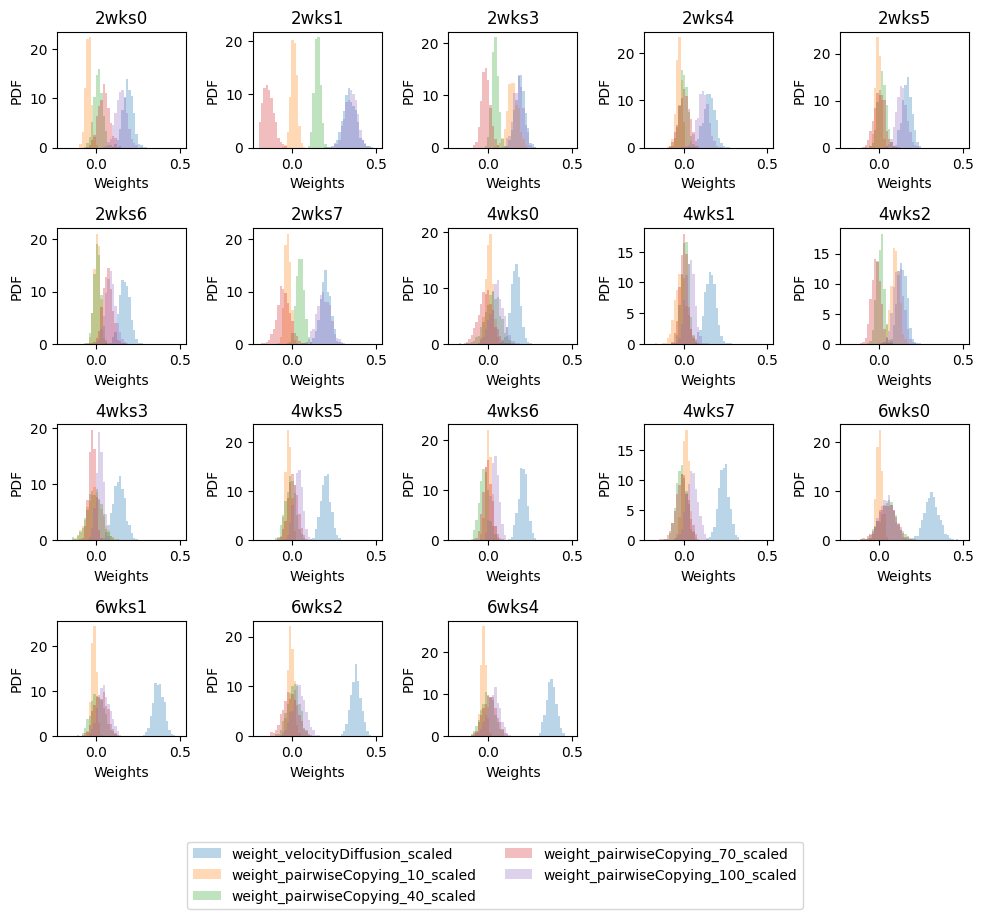

In [17]:
# plot a combined figure with all inference results

n_plots = len(all_exp_samples)

nrows = 4
ncols = np.ceil(n_plots/nrows).astype(int)

fig, ax = plt.subplots(nrows,ncols, figsize=(ncols*2,nrows*2))

for i,exp in enumerate(all_exp_samples.keys()):
    samples = all_exp_samples[exp]
    r = i // ncols
    c = i % ncols
    bins = np.linspace(-0.2,0.5,51)
    for key,values in samples.items():
        ax[r,c].hist(values, bins=bins, density=True, alpha = 0.3, label=key)
    
    ax[r,c].set_xlabel("Weights")
    ax[r,c].set_ylabel("PDF")
    ax[r,c].set_title(exp)

lines, labels = ax[0,0].get_legend_handles_labels()  # Get the labels from one subplot
fig.legend(lines, labels, loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=2)

# Adjust layout to make room for the legend
fig.tight_layout()


#remove extra plots 
if n_plots % ncols:
    ind = range(n_plots % ncols, ncols)
    for i in ind:
        fig.delaxes(ax[nrows-1,i])

